In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
! pip install rdkit pubchempy pyxlsb xlrd -q

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.1/33.1 MB 75.0 MB/s eta 0:00:00


In [ ]:
import os
import gc
import numpy as np
import pandas as pd
import seaborn as sns
from rdkit import Chem
import matplotlib.pyplot as plt
from rdkit.Chem import Descriptors
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# LifeStageData - Exploratory Analysis

In [ ]:
df_life_stage = pd.read_csv("Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/Life_Stage_Dataset.csv", index_col=0)
df_life_stage

,CAS Number,Chemical Name,Species Scientific Name,Species Common Name,Species Group,Organism Lifestage,Observed Duration Mean (Days),Exposure Type,Media Type,Conc 1 Mean (Standardized),Conc 1 Units (Standardized),Effect,Effect Measurement,Endpoint
0,50000,Formaldehyde,Lithobates catesbeianus,American Bullfrog,Amphibians; U.S. Invasive Species,Tadpole,4.00,Renewal,Fresh water,10.530000,AI mg/L,Mortality,Mortality,LC50
1,50180,"N,N-Bis(2-chloroethyl)tetrahydro-2H-1,3,2-oxaz...",Xenopus laevis,African Clawed Frog,Amphibians; Standard Test Species,Embryo,4.00,Renewal,Fresh water,6760.000000,AI mg/L,Mortality,Mortality,LC50
2,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians; Standard Test Species,Tadpole,14.00,Renewal,Fresh water,1.517198,AI mg/L,Mortality,Mortality,LC50
3,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians; Standard Test Species,Tadpole,14.00,Renewal,Fresh water,1.242087,AI mg/L,Mortality,Mortality,LC50
4,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates sylvaticus,Wood Frog,Amphibians; Standard Test Species,Tadpole,14.00,Renewal,Fresh water,0.680968,AI mg/L,Mortality,Mortality,LC50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167752,122548338,"2-Chloro-N-[[(4,6-dimethoxy-2-pyrimidinyl)amin...",Limnophila sessiliflora,Asian Marshweed,"Flowers, Trees, Shrubs, Ferns; U.S. Invasive S...",Seedling,60.88,Static,Fresh water,1244.710000,AI g/ha,Population,Biomass,EC50
167753,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns; Standard Test S...",Exponential growth phase (log),7.00,Renewal,Fresh water,0.000460,AI mg/L,Population,Biomass,EC50
167754,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns; Standard Test S...",Exponential growth phase (log),7.00,Static,Fresh water,0.000920,AI mg/L,Population,Biomass,EC50
167755,144740534,"2-[[[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbo...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns; Standard Test S...",Exponential growth phase (log),7.00,Static,Fresh water,0.000680,AI mg/L,Population,Biomass,EC50


In [ ]:
df_life_stage.info()

<class 'pandas.core.frame.DataFrame'>
Index: 167757 entries, 0 to 167756
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   CAS Number                     167757 non-null  int64  
 1   Chemical Name                  167757 non-null  object 
 2   Species Scientific Name        167757 non-null  object 
 3   Species Common Name            167757 non-null  object 
 4   Species Group                  167757 non-null  object 
 5   Organism Lifestage             167757 non-null  object 
 6   Observed Duration Mean (Days)  167757 non-null  float64
 7   Exposure Type                  167757 non-null  object 
 8   Media Type                     167757 non-null  object 
 9   Conc 1 Mean (Standardized)     167757 non-null  float64
 10  Conc 1 Units (Standardized)    167757 non-null  object 
 11  Effect                         167757 non-null  object 
 12  Effect Measurement             1677

In [ ]:
df_life_stage.describe(include='object')

,Chemical Name,Species Scientific Name,Species Common Name,Species Group,Organism Lifestage,Exposure Type,Media Type,Conc 1 Units (Standardized),Effect,Effect Measurement,Endpoint
count,167757,167757,167757,167757,167757,167757,167757,167757,167757,167757,167757
unique,4411,2334,1218,38,103,34,3,131,23,3624,4
top,Sulfuric acid copper(2+) salt (1:1),Danio rerio,Zebra Danio,Fish; Standard Test Species,Juvenile,Static,Fresh water,AI mg/L,Mortality,Mortality,NOEC
freq,6607,26256,26256,49584,25155,67397,128186,152698,56711,49560,60630


In [ ]:
df_life_stage.describe(include='float64')

,Observed Duration Mean (Days),Conc 1 Mean (Standardized)
count,167757.000000,1.677570e+05
mean,14.761971,1.826793e+06
std,45.275659,2.584172e+08
min,0.000000,0.000000e+00
25%,2.000000,3.200000e-02
50%,4.000000,5.000000e-01
75%,10.000000,8.696710e+00
max,1888.000000,5.236293e+10


In [ ]:
df_life_stage['Species Group'] = df_life_stage['Species Group'].str.replace('/', '&', regex=False).str.split(';').str[0]
df_life_stage['Species Group'].value_counts()

Species Group
Fish                             87049
Crustaceans                      30522
Insects&Spiders                  11803
Amphibians                       11316
Algae                            10442
Molluscs                          8177
Invertebrates                     4746
Worms                             1748
Flowers, Trees, Shrubs, Ferns     1534
Mammals                            238
Reptiles                           128
Fungi                               39
Moss, Hornworts                     15
Name: count, dtype: int64

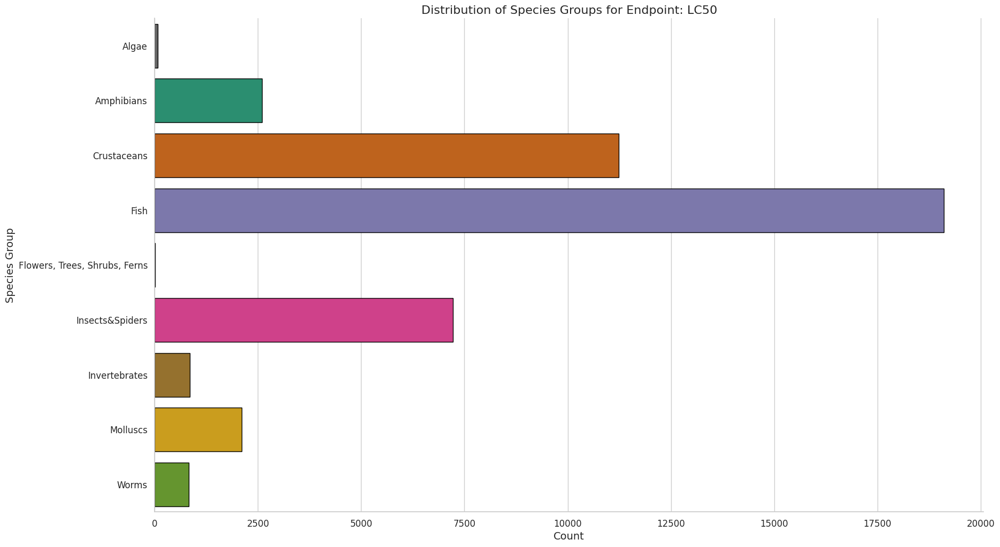

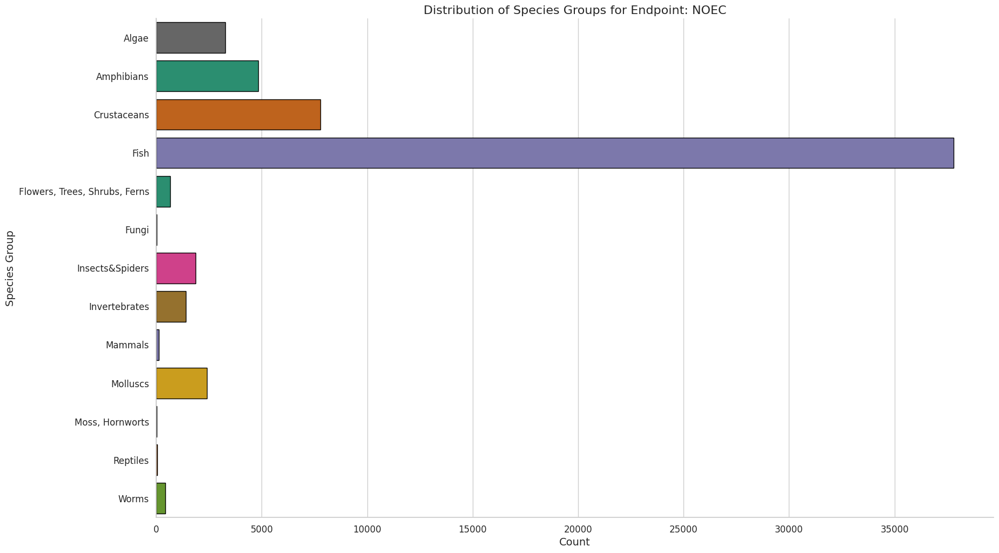

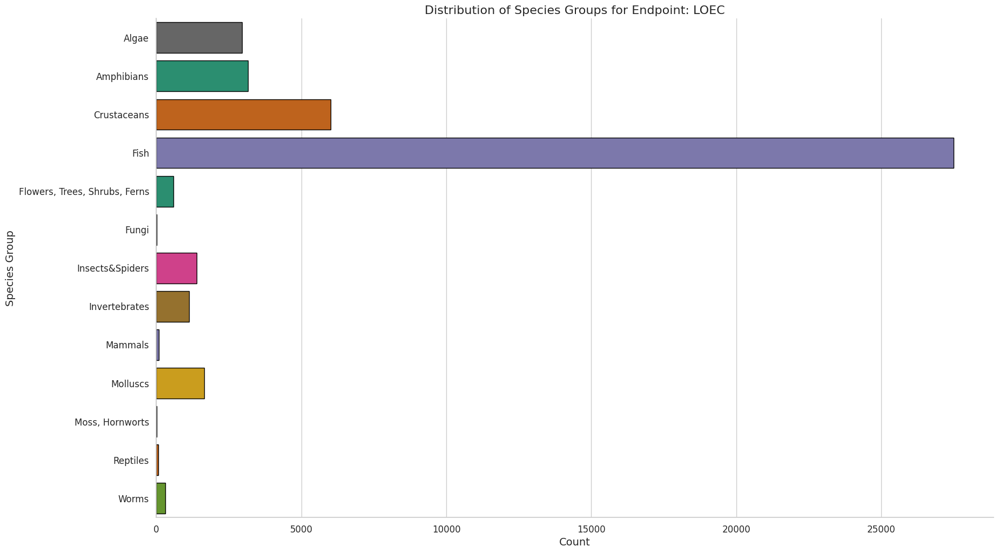

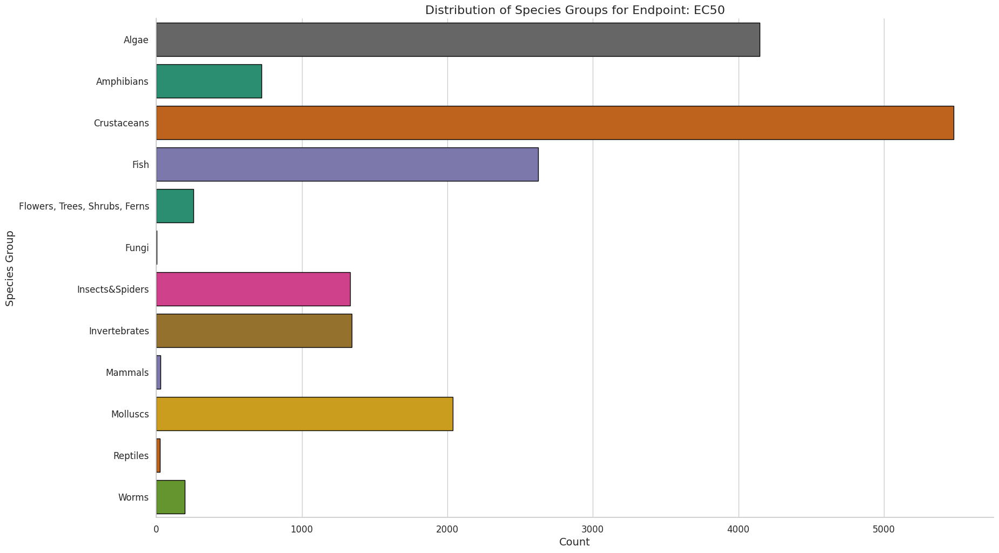

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set a seaborn style
sns.set(style="whitegrid")
# plt.tight_layout()  # Adjust layout to make room for labels

# Unique endpoints from df_life_stage
endpoints = df_life_stage['Endpoint'].unique()

# Create a consistent color palette for all species common names
species_common_names = df_life_stage['Species Group'].unique()
palette = sns.color_palette("Dark2", n_colors=len(species_common_names))
color_map = {species: color for species, color in zip(species_common_names, palette)}

# Iterate through each endpoint type and plot
for endpoint in endpoints:
    # Filter data for the current endpoint
    data = df_life_stage[df_life_stage['Endpoint'] == endpoint].groupby('Species Group').size()

    # Sort index to ensure consistent order in all plots
    data = data.sort_index()

    # Create the bar plot with a consistent color map
    plt.figure(figsize=(20, 12))
    ax = sns.barplot(y=data.index, x=data.values, palette=[color_map[sp] for sp in data.index], edgecolor='black')

    # Customizing the plot
    ax.set_title(f'Distribution of Species Groups for Endpoint: {endpoint}', fontsize=16)
    ax.set_xlabel('Count', fontsize=14)
    ax.set_ylabel('Species Group', fontsize=14)
    ax.xaxis.set_tick_params(labelsize=12)
    ax.yaxis.set_tick_params(labelsize=12)

    # Remove unnecessary spines
    sns.despine()

    # Save each plot as a high-resolution PNG file
    plt.savefig(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Figures/LifeStageData-species_distribution_{endpoint}.png')

    # Show the plot
    plt.show()

In [ ]:
# Calculate the counts of each life stage within each species group
life_stages = df_life_stage.groupby(['Species Group', 'Organism Lifestage']).size()

# Structure to hold the data
species_group_data = {}

# Populate the dictionary with species groups and their respective life stages
for (species_group, life_stage), count in life_stages.items():
    if species_group not in species_group_data:
        species_group_data[species_group] = {}
    species_group_data[species_group][life_stage] = count

# Printing each species group and the counts of each life stage
for species_group, life_stages in species_group_data.items():
    print(f"Species Group: {species_group}")
    for life_stage, count in life_stages.items():
        print(f"  {life_stage}: {count}")
    print()  # for better readability with an extra newline

Species Group: Algae
  Adult: 16
  Embryo: 23
  Exponential growth phase (log): 4788
  Gamete: 1
  Germinated seed: 6
  Juvenile: 46
  Larva: 5
  Mature: 9
  Multiple: 13
  Post-emergence: 1
  Sperm: 13
  Spore: 60
  Sporeling: 1
  Stationary growth phase: 22
  Tissue culture callus: 13
  Zygospore: 27
  Zygote: 5

Species Group: Algae; Standard Test Species
  Egg: 1
  Exponential growth phase (log): 5187
  F11 generation: 3
  Gamete: 63
  Juvenile: 21
  Lag growth phase: 8
  Mature: 30
  Neonate: 10
  Spore: 12
  Stationary growth phase: 58

Species Group: Amphibians
  Adult: 207
  Blastula: 56
  Cleavage stage: 4
  Egg: 209
  Embryo: 483
  Gastrula: 12
  Juvenile: 8
  Lactational: 2
  Larva: 776
  Mature: 6
  Multiple: 13
  Neurala: 1
  New, newly or recent hatch: 2
  Not intact: 16
  Oocyte, ova: 6
  Pre-, sub-, semi-, near adult, or peripubertal: 2
  Sperm: 48
  Tadpole: 2684
  Young: 5

Species Group: Amphibians; Standard Test Species
  Adult: 182
  Blastula: 235
  Cleavage stage:

In [ ]:
# Flattening the dictionary
data = []
for species, life_stages in species_group_data.items():
    for life_stage, count in life_stages.items():
        data.append({'Species Group': species, 'Life Stage': life_stage, 'Count': count})

# Create DataFrame
df = pd.DataFrame(data)

# Example of standardizing life stage names
df['Life Stage'] = df['Life Stage'].str.lower()  # Convert to lower case
df['Life Stage'] = df['Life Stage'].str.strip()  # Remove leading/trailing spaces

# Replace specific mislabelings (customize as needed)
df['Life Stage'] = df['Life Stage'].replace({'juveniles': 'juvenile', 'larvas': 'larva'})
df = df.groupby(['Species Group', 'Life Stage']).sum().reset_index()

# Pivot the DataFrame
pivot_df = df.pivot_table(index='Life Stage', columns='Species Group', values='Count', fill_value=0)

# Display the pivoted DataFrame
pivot_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Stats/LifeStage - Data Distribution before processing.csv')

In [ ]:
pivot_df

Species Group,Algae,Algae; Standard Test Species,Amphibians,Amphibians; Standard Test Species,Amphibians; U.S. Invasive Species,Amphibians; U.S. Threatened and Endangered Species,Crustaceans,Crustaceans; Standard Test Species,Crustaceans; Standard Test Species; U.S. Invasive Species,Crustaceans; U.S. Invasive Species,...,Molluscs; Standard Test Species,Molluscs; Standard Test Species; U.S. Invasive Species,Molluscs; U.S. Invasive Species,Molluscs; U.S. Threatened and Endangered Species,"Moss, Hornworts",Reptiles,Reptiles; U.S. Threatened and Endangered Species,Worms,Worms; Standard Test Species,Worms; U.S. Invasive Species
Life Stage,,,,,,,,,,,,,,,,,,,,,
adult,16,0,207,182,10,0,2973,3144,28,154,...,419,105,256,1,0,0,0,622,226,0
alevin,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
blastula,0,0,56,235,0,0,0,0,0,0,...,7,0,0,0,0,0,0,5,0,0
bud or budding,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
cleavage stage,0,0,4,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
young adult,0,0,0,21,0,0,21,14,0,0,...,30,0,0,0,0,0,0,0,56,0
young of year,0,0,0,0,0,0,7,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zoea,0,0,0,0,0,0,371,5,3,1,...,0,0,0,0,0,0,0,0,0,0


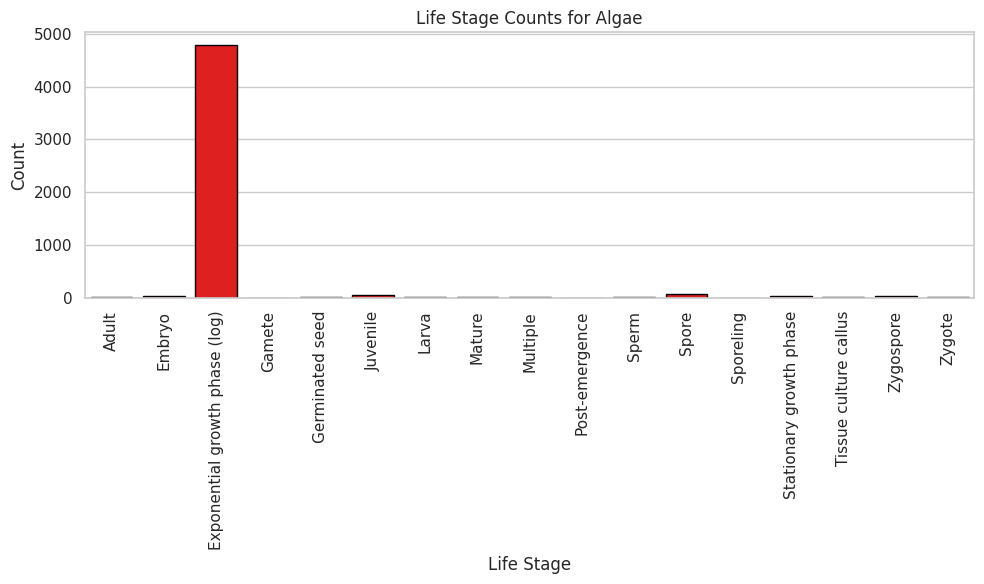

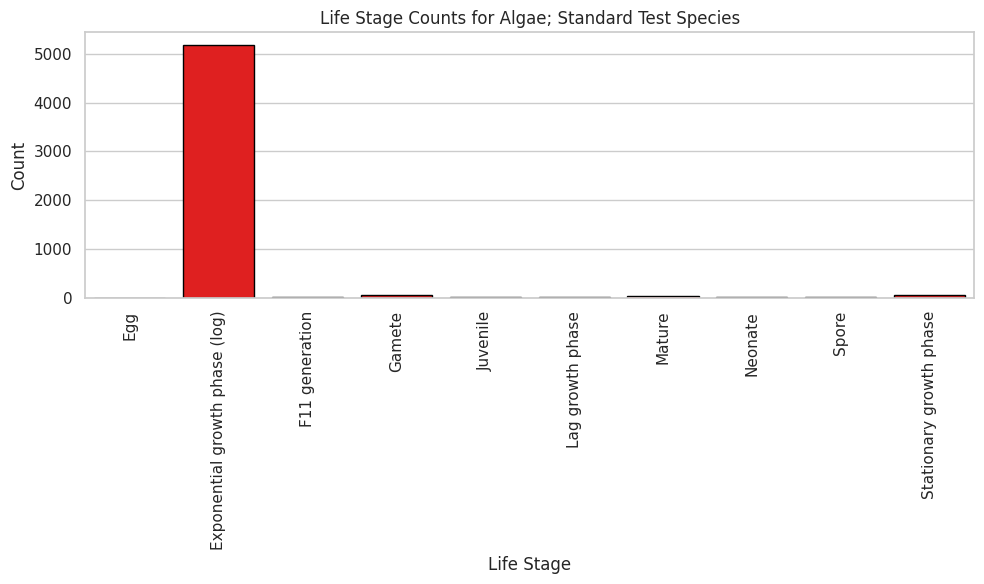

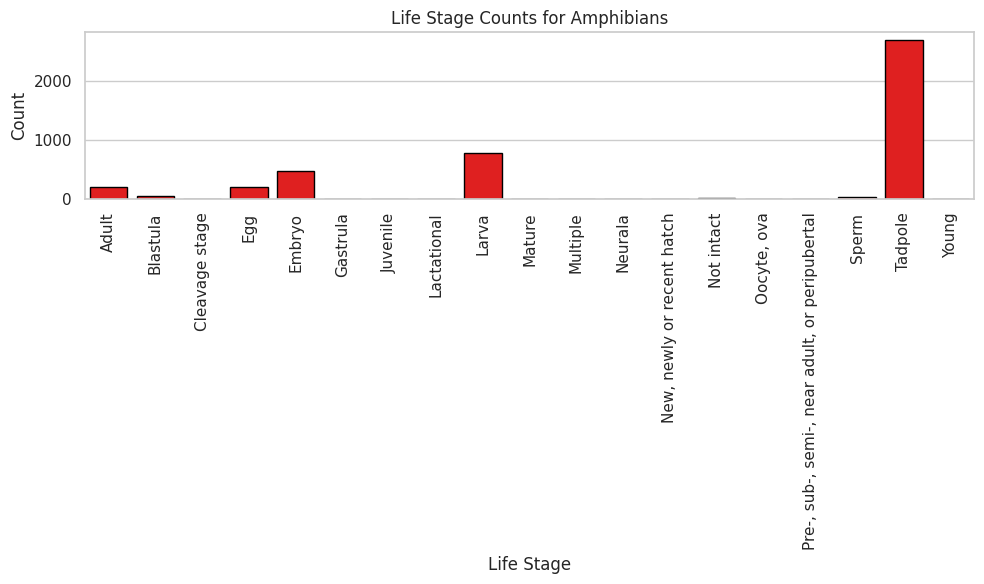

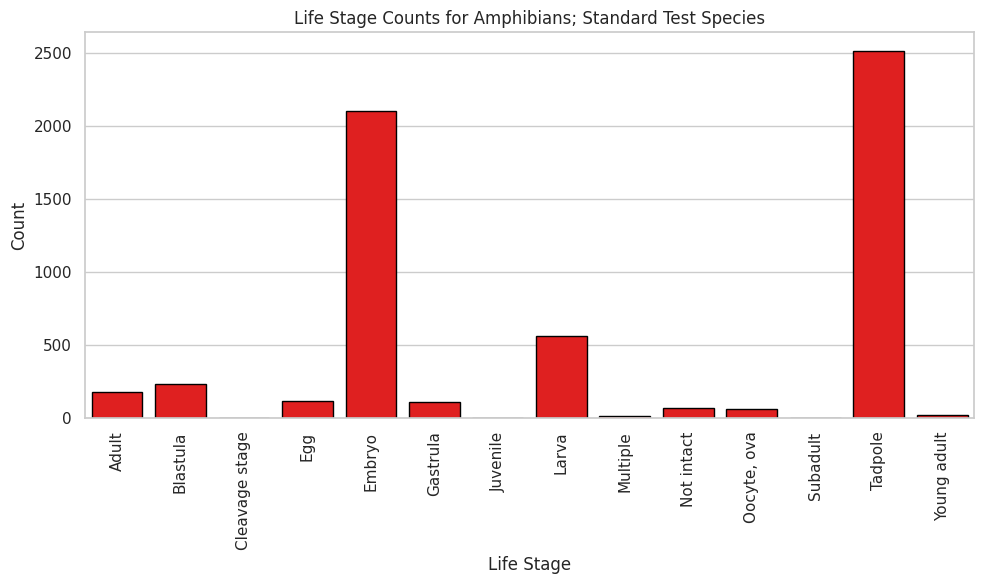

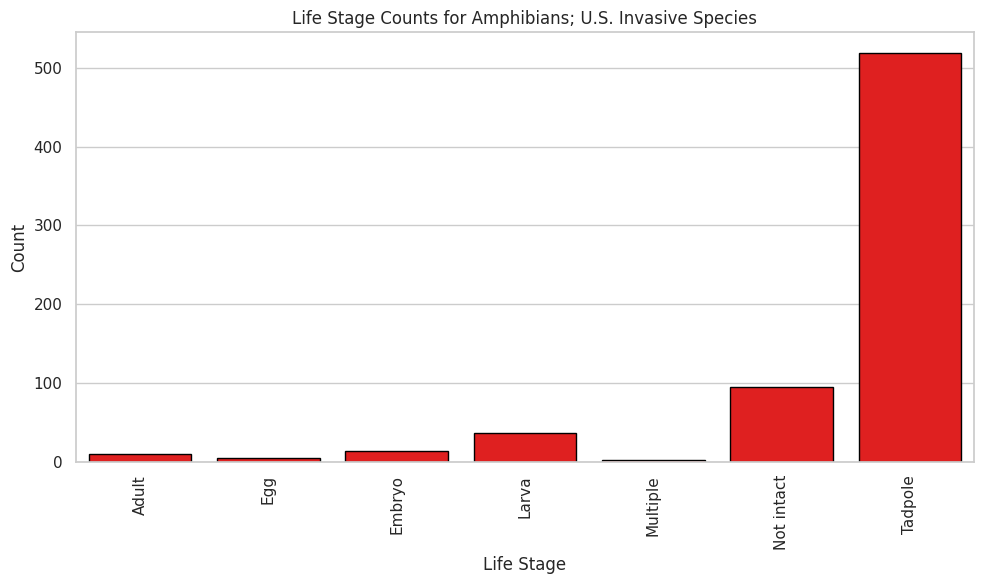

...

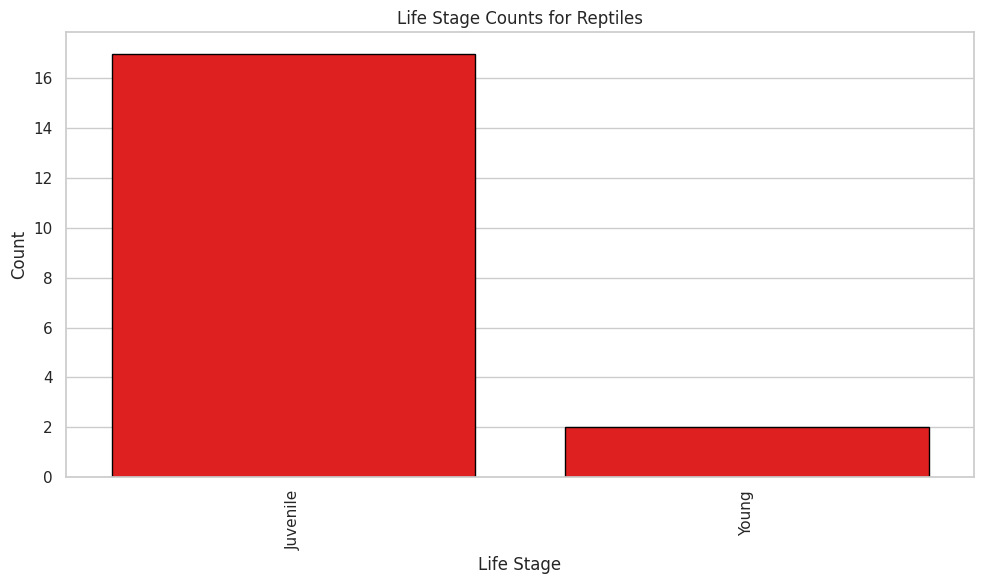

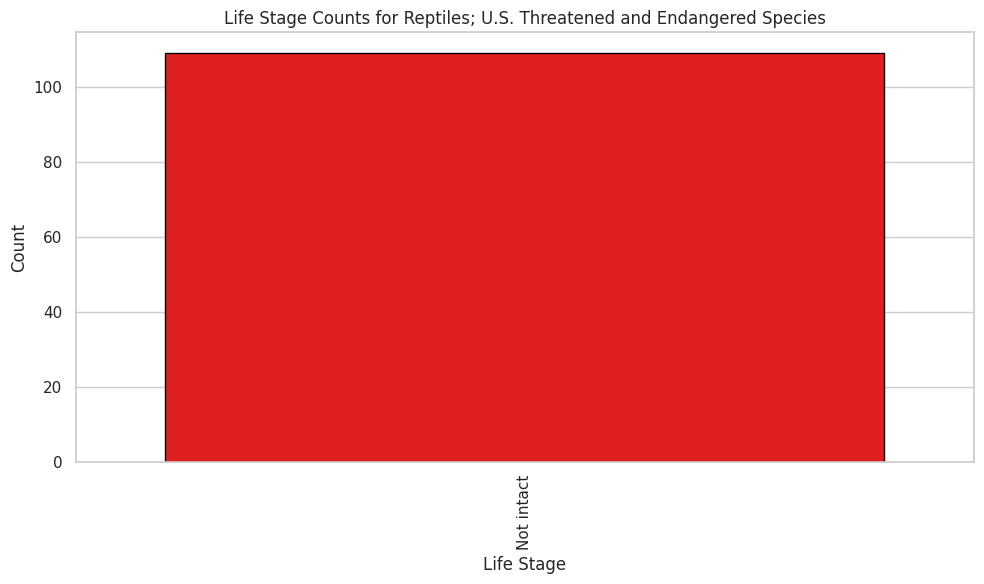

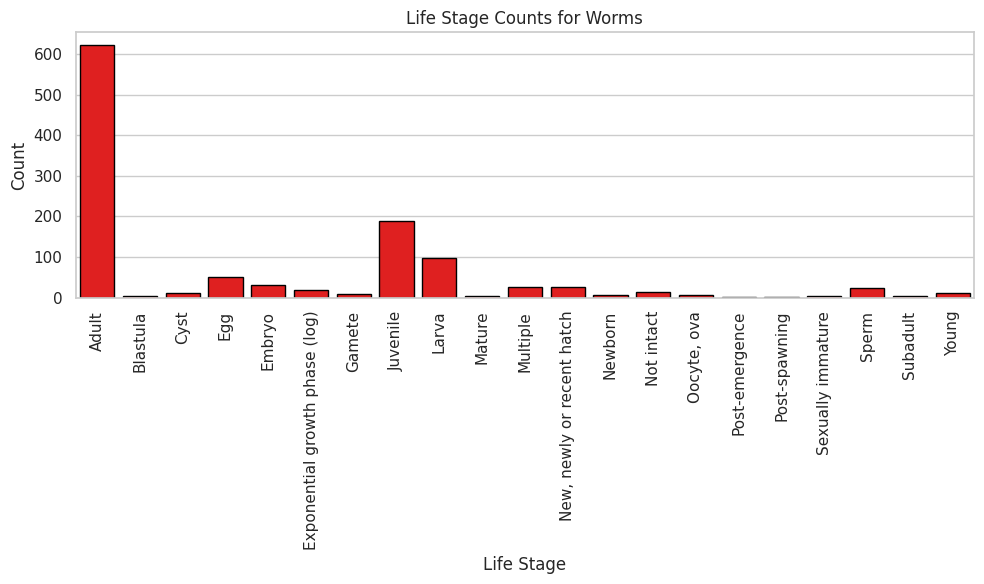

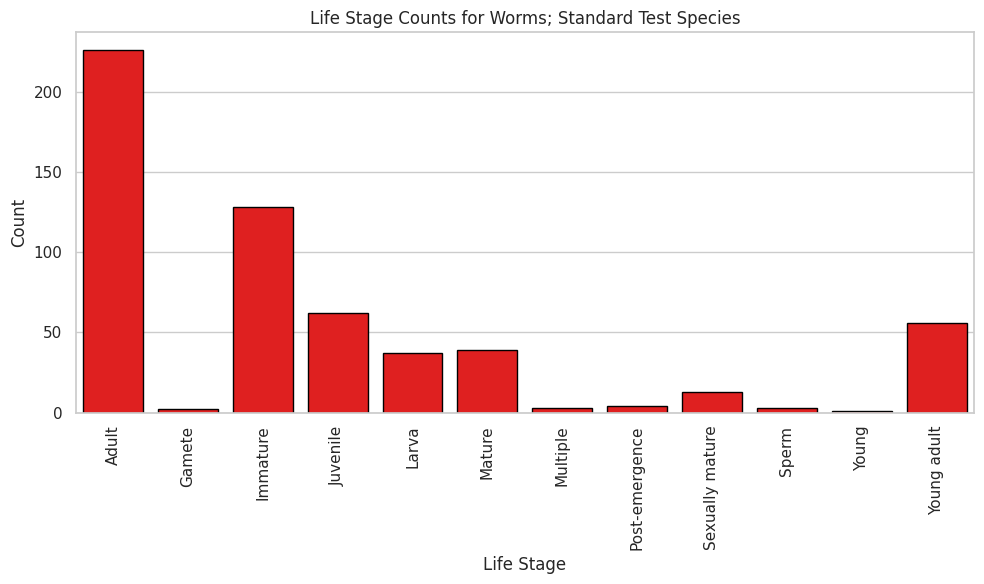

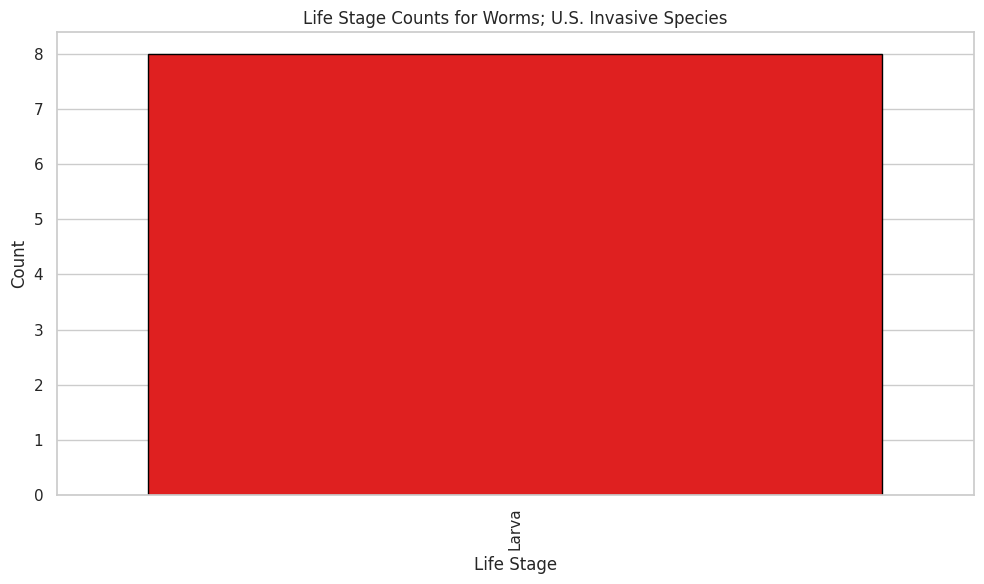

In [ ]:
# Prepare the data dictionary correctly
data = {
    'Species Group': [],
    'Life Stage': [],
    'Count': []
}

# Flatten the nested dictionary into the list structure of the 'data' dictionary
for species, stages in species_group_data.items():
    for stage, count in stages.items():
        data['Species Group'].append(species)
        data['Life Stage'].append(stage)
        data['Count'].append(count)

# Create DataFrame from the data dictionary
df = pd.DataFrame(data)

# Get unique species for looping
species_list = df['Species Group'].unique()

# Create a separate plot for each species
for species in species_list:
    # Filter the data for the current species
    df_species = df[df['Species Group'] == species]

    # Plotting the data using seaborn
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Life Stage', y='Count', data=df_species, edgecolor='black', color='red')

    # Customizing the plot
    plt.title(f'Life Stage Counts for {species}')
    plt.xlabel('Life Stage')
    plt.ylabel('Count')
    plt.xticks(rotation=90)  # Rotate x-labels for better readability
    plt.tight_layout()  # Adjust layout to make sure everything fits without clipping
    plt.show()

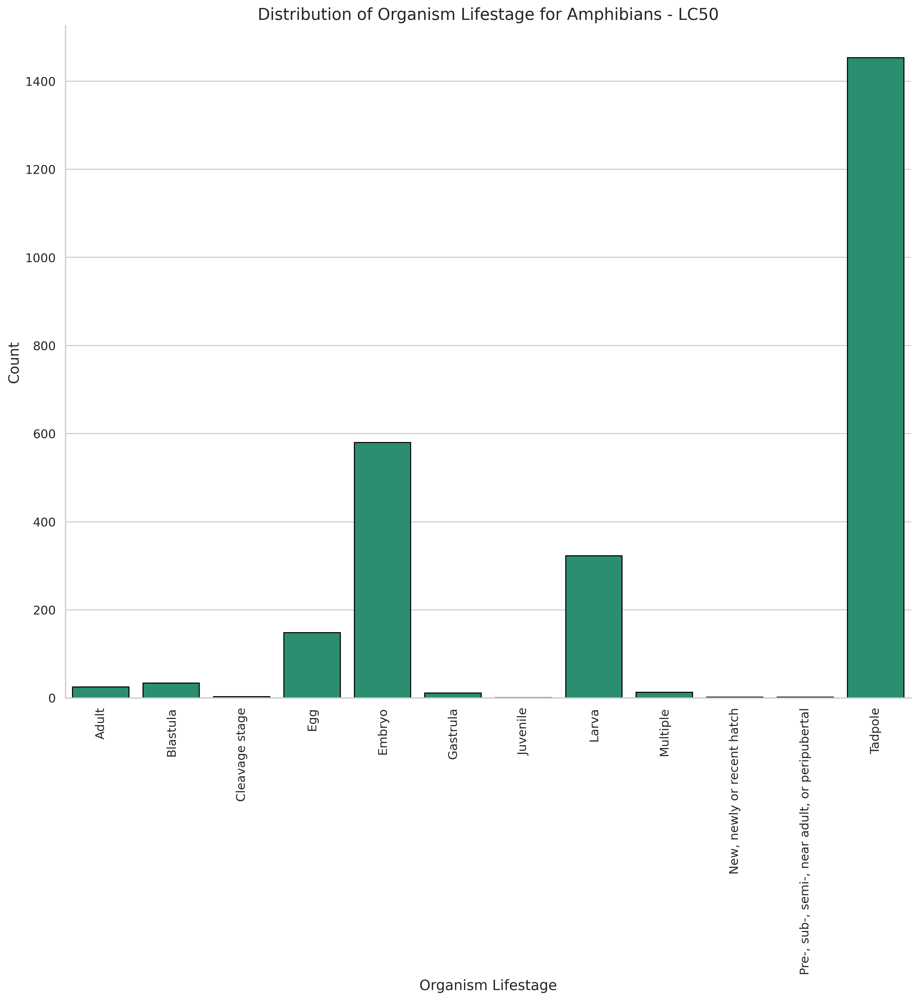

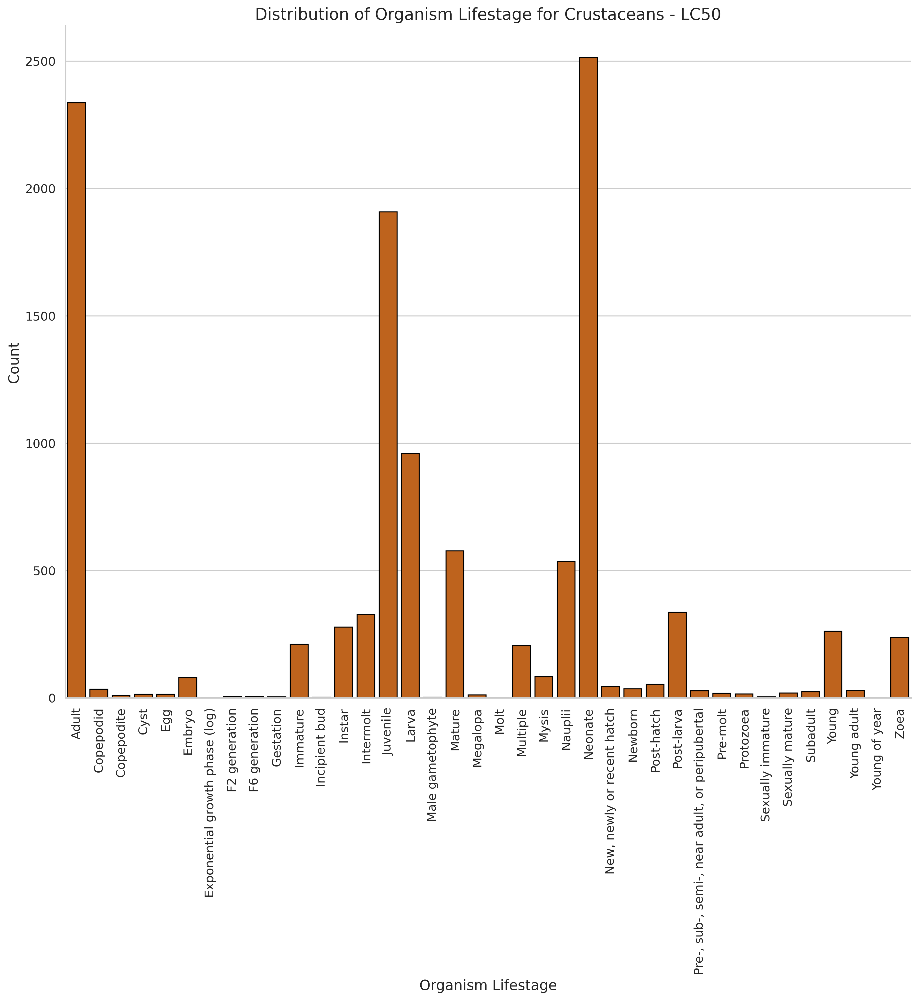

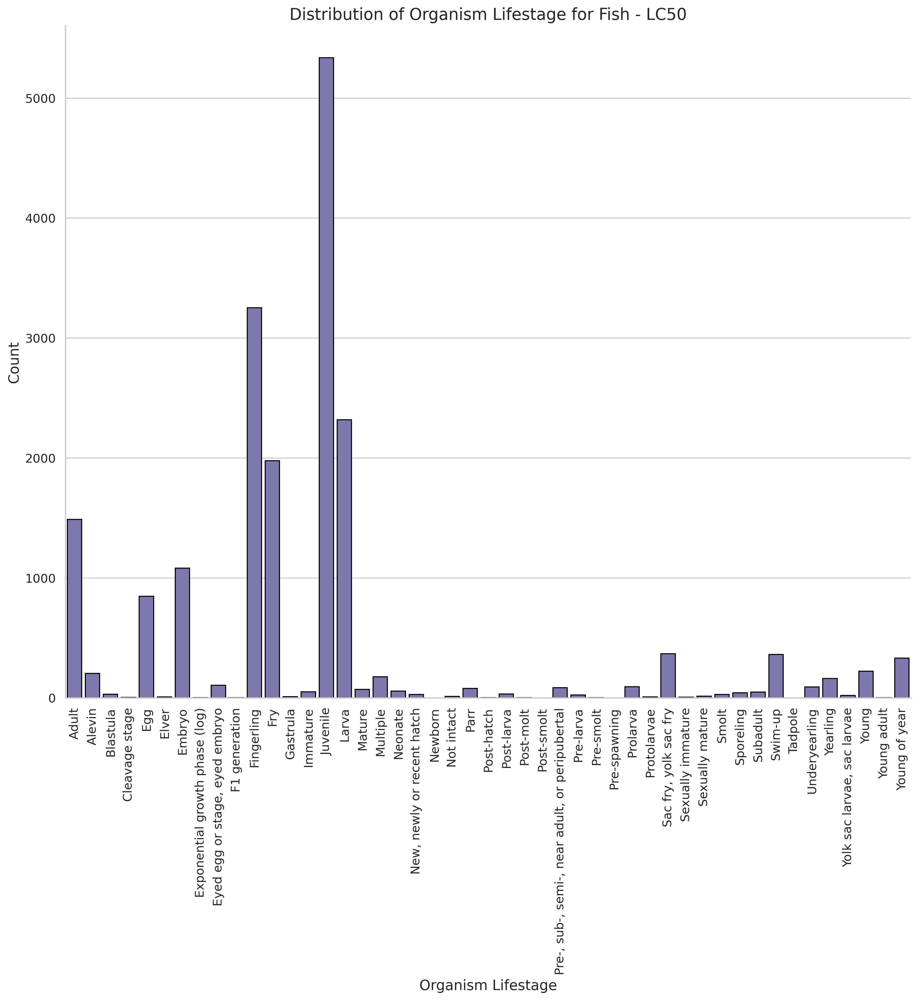

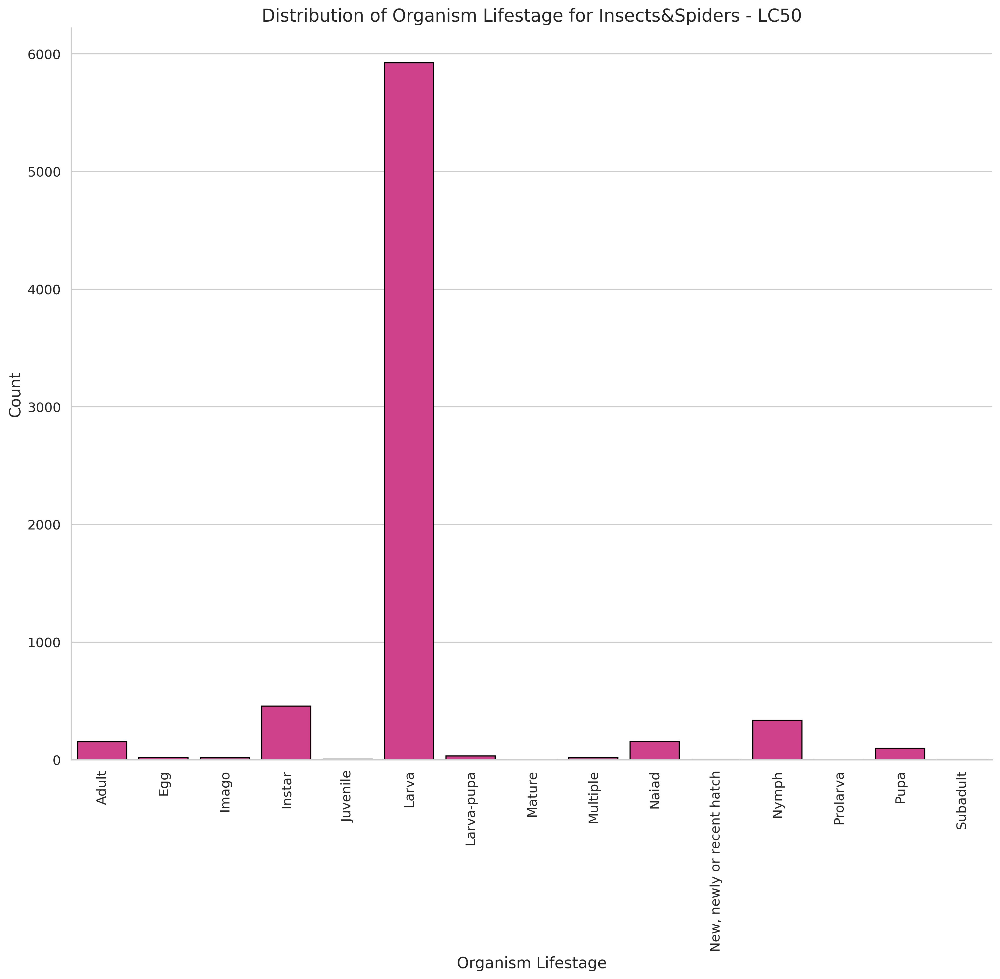

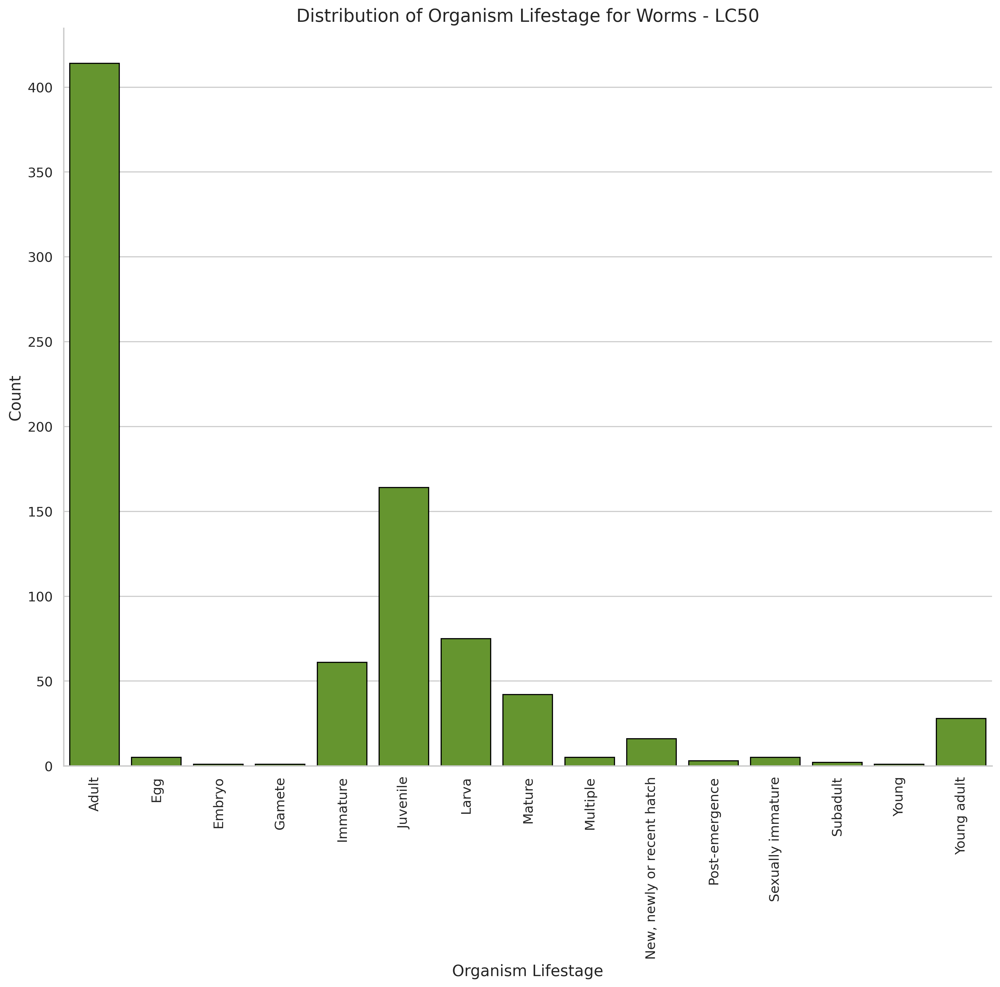

...

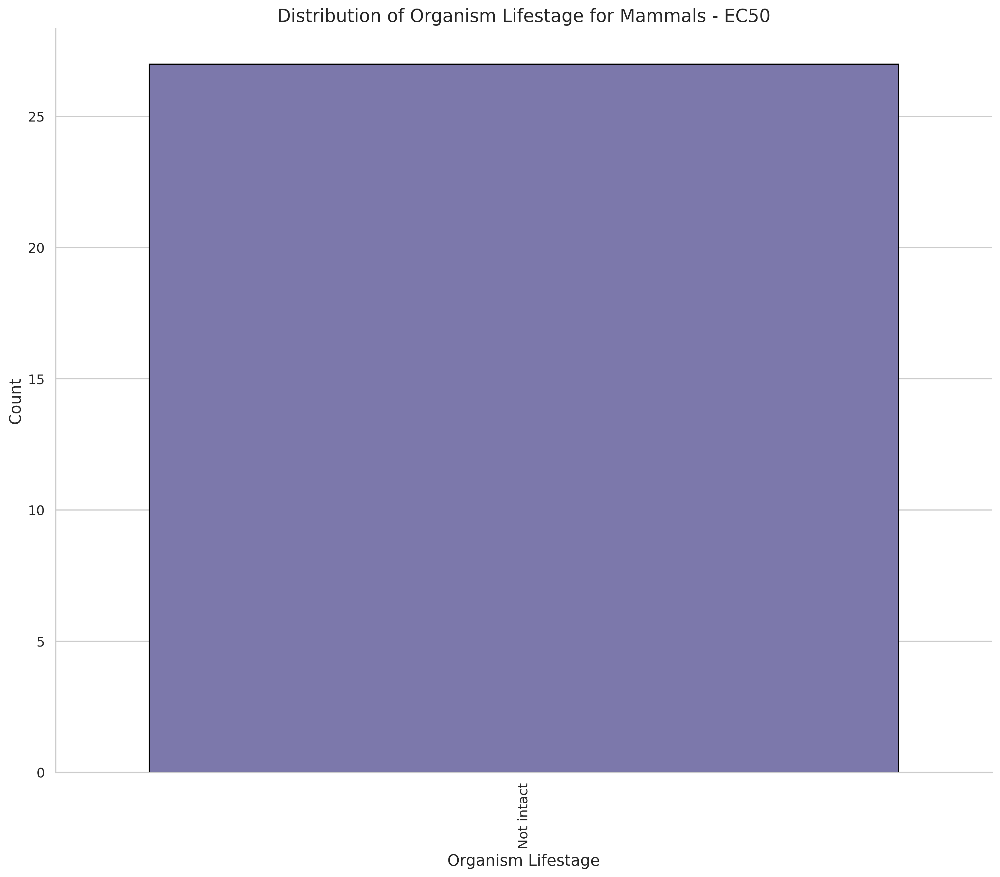

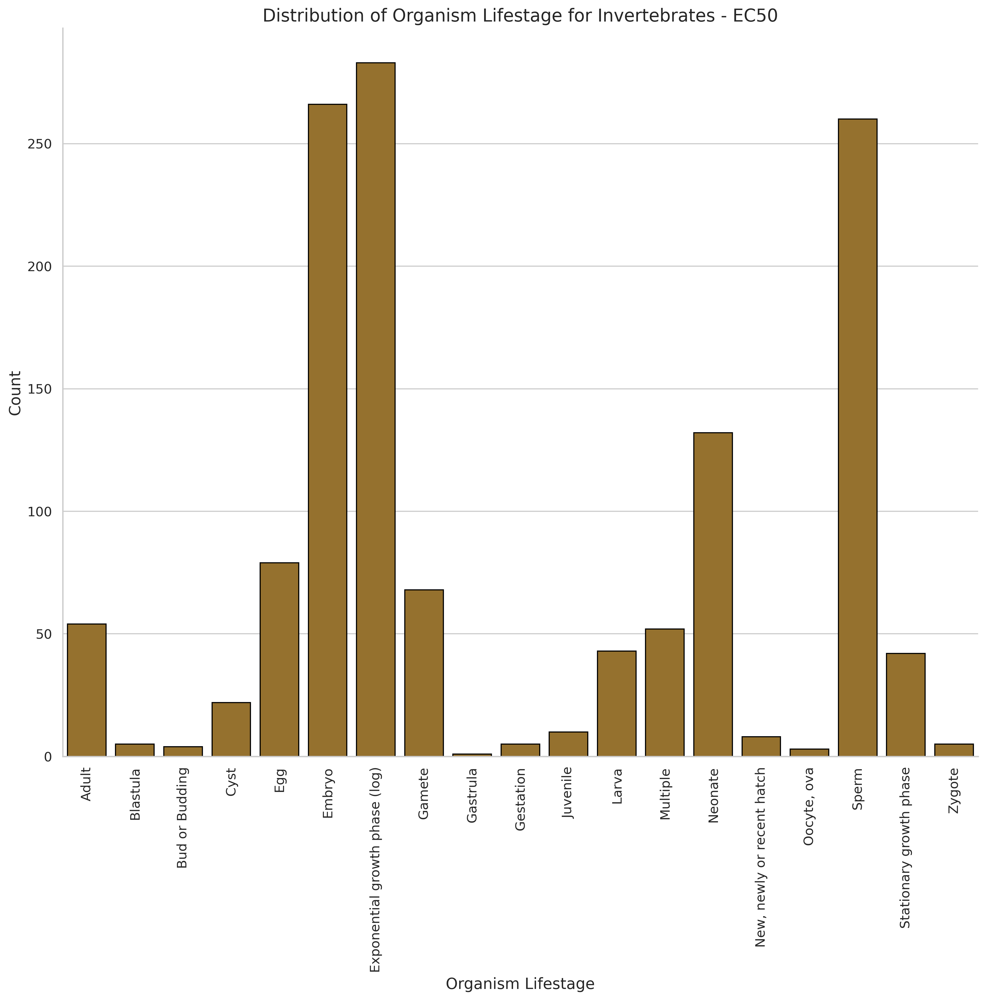

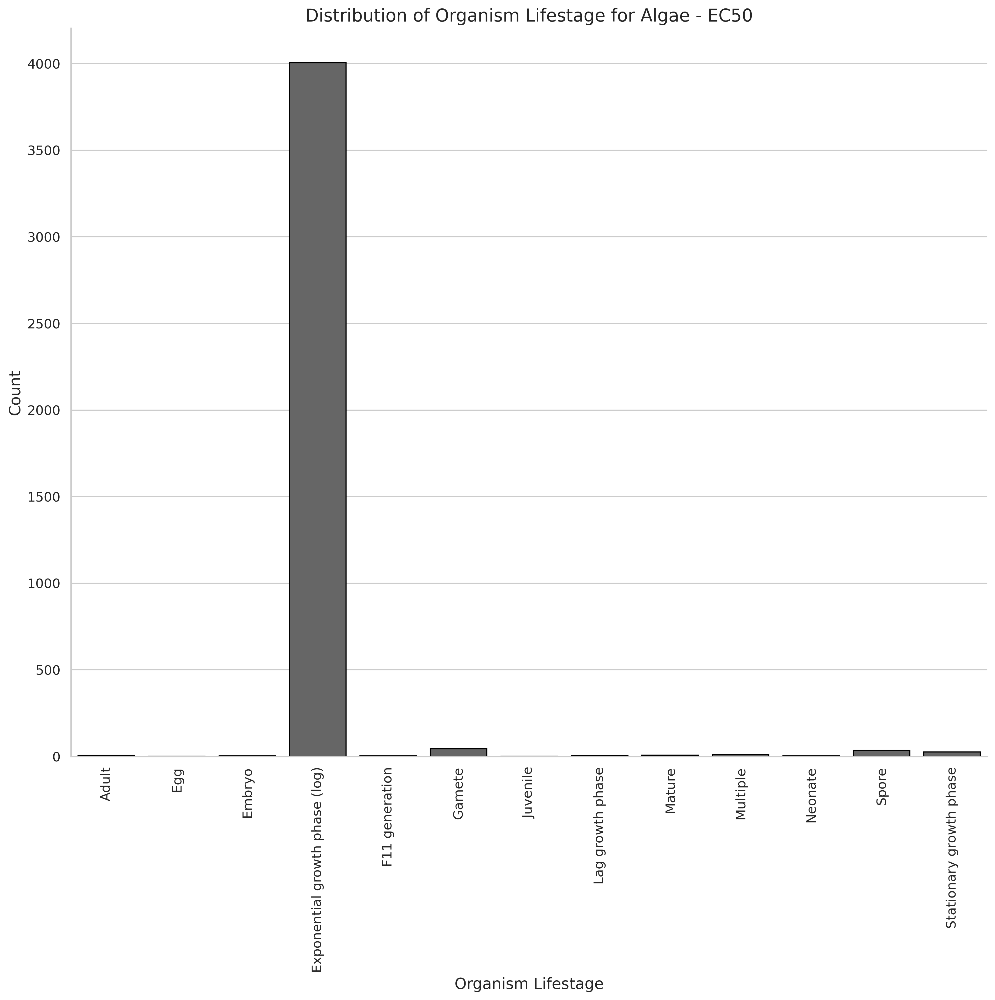

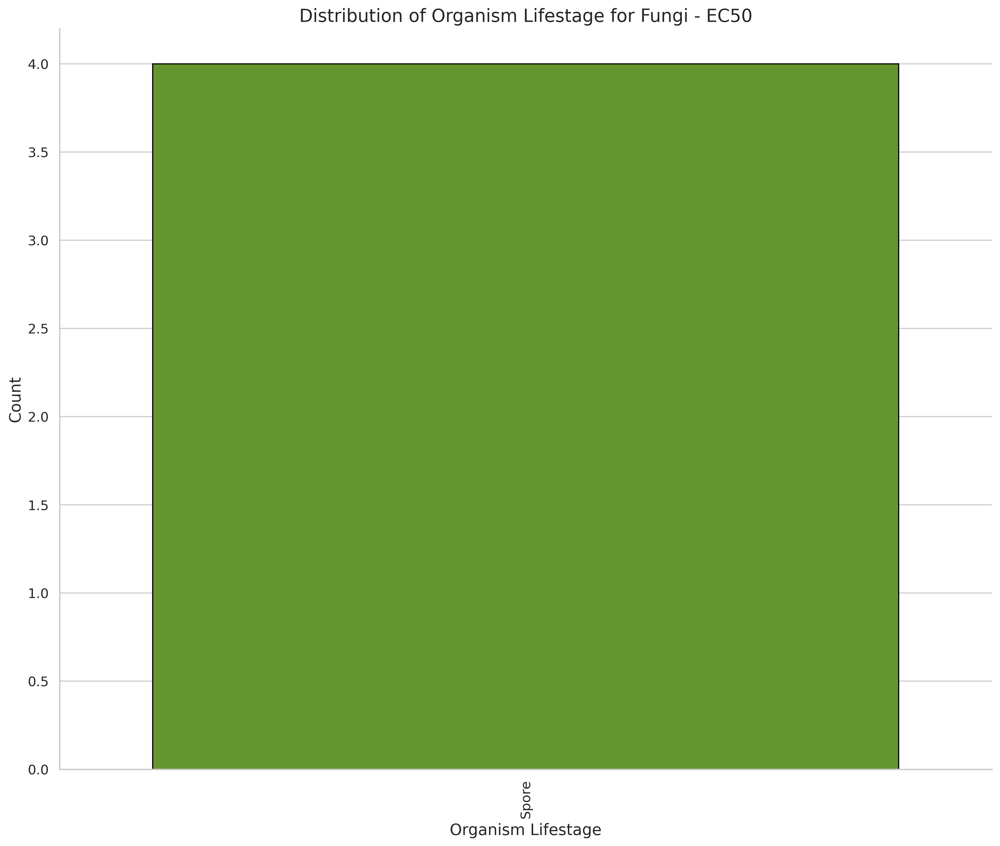

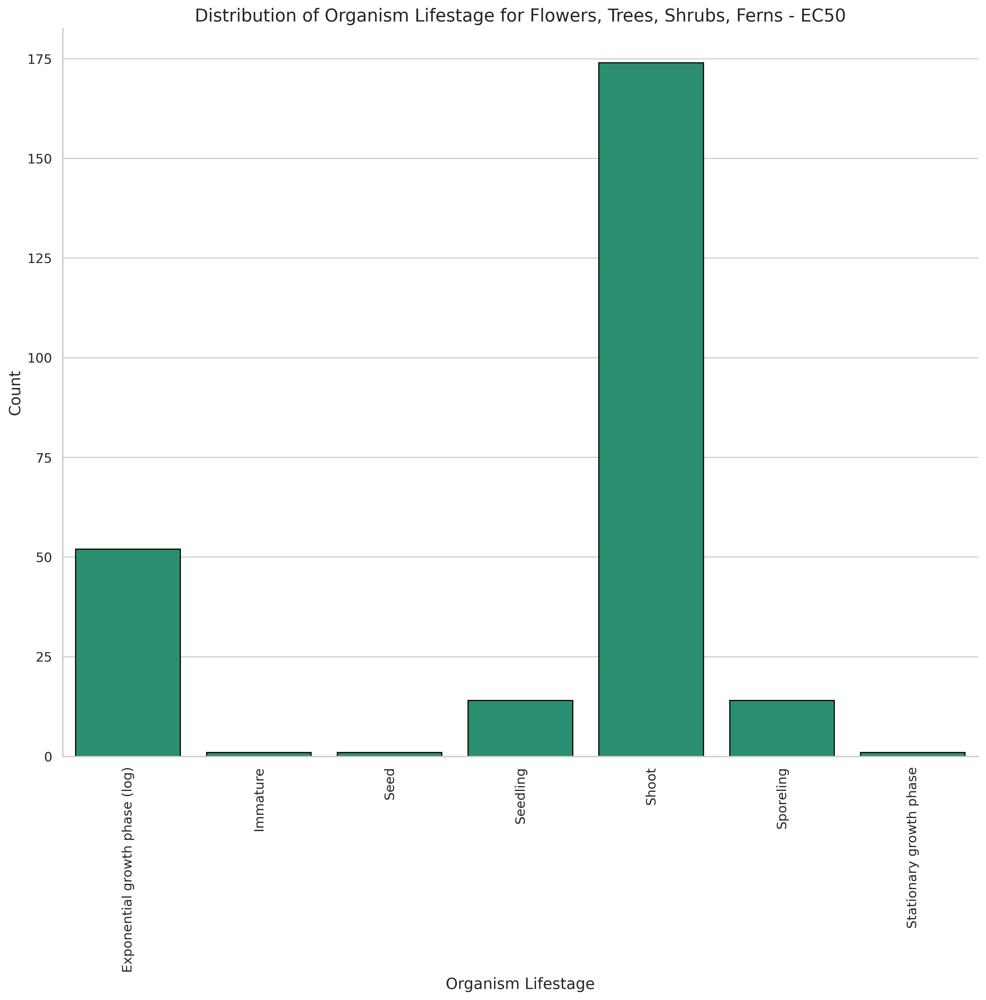

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set a seaborn style
sns.set(style="whitegrid")

# Ensure the color palette includes all unique species common names
species_common_names = df_life_stage['Species Group'].unique()
palette = sns.color_palette("Dark2", n_colors=len(species_common_names))
color_map = {species: color for species, color in zip(species_common_names, palette)}

# Get all unique endpoints from df_life_stage
endpoints = df_life_stage['Endpoint'].unique()

# Iterate through each endpoint type
for endpoint in endpoints:
    # Filter data for the current endpoint
    df_endpoint = df_life_stage[df_life_stage['Endpoint'] == endpoint]

    # Get unique species for the current endpoint
    species_in_endpoint = df_endpoint['Species Group'].unique()

    for species in species_in_endpoint:
        # Filter data for the current species within the current endpoint
        df_species = df_endpoint[df_endpoint['Species Group'] == species]

        # Check if 'Organism Lifestage' has any data
        if 'Organism Lifestage' in df_species.columns and not df_species['Organism Lifestage'].isna().all():
            # Group data by 'Organism Lifestage' and count occurrences
            lifestage_counts = df_species['Organism Lifestage'].value_counts().sort_index()

            # Create the bar plot with a consistent color map if there are any lifestages
            if not lifestage_counts.empty:
                plt.figure(figsize=(15, 12), dpi=300)
                plt.tight_layout()  # Adjust layout to make room for labels
                ax = sns.barplot(x=lifestage_counts.index, y=lifestage_counts.values, color=color_map.get(species, 'gray'), edgecolor='black')

                # Customizing the plot
                ax.set_title(f'Distribution of Organism Lifestage for {species} - {endpoint}', fontsize=16)
                ax.set_xlabel('Organism Lifestage', fontsize=14)
                ax.set_ylabel('Count', fontsize=14)
                ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
                ax.xaxis.set_tick_params(labelsize=12)
                ax.yaxis.set_tick_params(labelsize=12)

                # Remove unnecessary spines
                sns.despine()

                # Save each plot as a high-resolution PNG file
                plt.savefig(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Figures/LifeStageData-lifestage_distribution_{species}_{endpoint}.png',
                            dpi=300, bbox_inches='tight')

                # Show the plot
                plt.show()

In [ ]:
# Calculate the value counts for the 'Species Group' column
species_counts = df_life_stage['Species Group'].value_counts()

# Filter the counts to include only those greater than 1000
filtered_counts = species_counts[species_counts > 1000]
list(filtered_counts.keys())

['Fish',
 'Crustaceans',
 'Insects&Spiders',
 'Amphibians',
 'Algae',
 'Molluscs',
 'Invertebrates',
 'Worms',
 'Flowers, Trees, Shrubs, Ferns']

In [ ]:
df_life_stage.to_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/0.LifeStageData-LifeSatgeDataProcessed.csv', index=False)

# Mapping Life Stages to Broad Life Stage Groups

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

df_life_stage = pd.read_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/0.LifeStageData-LifeSatgeDataProcessed.csv')

In [ ]:
stage_to_group = {
    'Algae' : {
        "Adult": 'Reproductive stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "F11 generation": 'Multiple Stages',
        "Gamete": 'Reproductive stage',
        "Germinated seed": 'Early development stage',
        "Juvenile": 'Growth and maturation stage',
        "Lag growth phase": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple Stages',
        "Neonate": 'Early development stage',
        "Post-emergence": 'Growth and maturation stage',
        "Sperm": 'Reproductive stage',
        "Spore": 'Reproductive stage',
        "Sporeling": 'Early development stage',
        "Stationary growth phase": 'Growth and maturation stage',
        "Tissue culture callus": 'Early development stage',
        "Zygospore": 'Early development stage',
        "Zygote": 'Early development stage'
    },

    'Amphibians' : {
        "Adult": 'Reproductive stage',
        "Blastula": 'Early development stage',
        "Cleavage stage": 'Early development stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Gastrula": 'Early development stage',
        "Juvenile": 'Growth and maturation stage',
        "Lactational": 2, # remove
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple Stages',
        "Neurala": 'Early development stage', #rename to Neurula
        "New, newly or recent hatch": 'Early development stage',
        "Not intact": 'Not intact',
        "Oocyte, ova": 'Reproductive stage',
        "Pre-, sub-, semi-, near adult, or peripubertal": 'Growth and maturation stage',
        "Sperm": 'Reproductive stage',
        "Subadult": 'Growth and maturation stage',
        "Tadpole": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage',
        "Young adult": 'Growth and maturation stage'
    },

    'Crustaceans' : {
        "Adult": 'Reproductive stage',
        "Copepodid": 'Growth and maturation stage',
        "Copepodite": 'Growth and maturation stage',
        "Cyst": 'Reproductive stage',
        "Egg": 'Reproductive stage',
        "Egg laying": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "F0 generation": 'Multiple Stages',
        "FO generation": 'Multiple stages',
        "F1 generation": 'Multiple Stages',
        "F2 generation": 'Multiple Stages',
        "F3 generation": 'Multiple Stages',
        "F6 generation": 'Multiple Stages',
        "F7 generation": 'Multiple Stages',
        "Flower opening": 3, #remove
        "Gastrula": 'Early development stage',
        "Gestation": 'Reproductive stage', #rename to Brooding
        "Immature": 'Growth and maturation stage',
        "Incipient bud": 'Growth and maturation stage',
        "Instar": 'Growth and maturation stage',
        "Intermolt": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Male gametophyte": 'Reproductive stage',
        "Mature": 'Growth and maturation stage',
        "Megalopa": 'Growth and maturation stage',
        "Molt": 'Growth and maturation stage',
        "Morula": 'Early development stage',
        "Multiple": 'Multiple Stages',
        "Mysis": 'Growth and maturation stage',
        "Nauplii": 'Early development stage',
        "Neonate": 'Early development stage',
        "New, newly or recent hatch": 'Early development stage',
        "Newborn": 'Early development stage',
        "Not intact": 'Not intact',
        "Post-hatch": 'Early development stage',
        "Post-larva": 'Growth and maturation stage',
        "Post-spawning": 'Reproductive stage',
        "Pre-, sub-, semi-, near adult, or peripubertal": 'Growth and maturation stage',
        "Pre-molt": 'Growth and maturation stage',
        "Protozoea": 'Growth and maturation stage',
        "Sexually immature": 'Growth and maturation stage',
        "Sexually mature": 'Reproductive stage',
        "Sperm": 'Reproductive stage',
        "Subadult": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage',
        "Young adult": 'Growth and maturation stage',
        "Young of year": 'Growth and maturation stage',
        "Zoea": 'Growth and maturation stage'
    },

    'Fish' : {
        "Adult": 'Reproductive stage',
        "Alevin": 'Early development stage',
        "Blastula": 'Early development stage',
        "Cleavage stage": 'Early development stage',
        "Egg": 'Reproductive stage',
        "Elver": 'Growth and maturation stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "Eyed egg or stage, eyed embryo": 'Early development stage',
        "F0 generation": 'Multiple stages',
        "FO generation": 'Multiple stages',
        "F1 generation": 'Multiple stages',
        "Fingerling": 'Growth and maturation stage',
        "Fry": 'Growth and maturation stage',
        "Gamete": 'Reproductive stage',
        "Gastrula": 'Early development stage',
        "Gestation": 'Reproductive stage',
        "Immature": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Mature reproductive": 'Reproductive stage',
        "Morula": 'Early development stage',
        "Multiple": 'Multiple stages',
        "Neonate": 'Early development stage',
        "Neurala": 'Early development stage',
        "New, newly or recent hatch": 'Early development stage',
        "Newborn": 'Early development stage',
        "Not intact": 'Not intact',
        "Oocyte, ova": 'Reproductive stage',
        "Parr": 'Growth and maturation stage',
        "Post-hatch": 'Early development stage',
        "Post-larva": 'Growth and maturation stage',
        "Post-molt": 'Growth and maturation stage',
        "Post-smolt": 'Growth and maturation stage',
        "Post-spawning": 'Reproductive stage',
        "Pre-, sub-, semi-, near adult, or peripubertal": 'Growth and maturation stage',
        "Pre-larva": 'Early development stage',
        "Pre-smolt": 'Growth and maturation stage',
        "Pre-spawning": 'Reproductive stage',
        "Prolarva": 'Early development stage',
        "Protolarvae": 'Early development stage',
        "Sac fry, yolk sac fry": 'Early development stage',
        "Sexually immature": 'Growth and maturation stage',
        "Sexually mature": 'Reproductive stage',
        "Smolt": 'Growth and maturation stage',
        "Spawning": 'Reproductive stage',
        "Sperm": 'Reproductive stage',
        "Sporeling": 'Early development stage',
        "Subadult": 'Growth and maturation stage',
        "Swim-up": 'Growth and maturation stage',
        "Tadpole": 'Growth and maturation stage',
        "Underyearling": 'Growth and maturation stage',
        "Virgin": 'Reproductive stage',
        "Yearling": 'Growth and maturation stage',
        "Yolk sac larvae, sac larvae": 'Early development stage',
        "Young": 'Growth and maturation stage',
        "Young adult": 'Growth and maturation stage',
        "Young of year": 'Growth and maturation stage',
        "Zygote": 'Early development stage'
    },

    'Flowers, Trees, Shrubs, Ferns' : {
        "Adult": 'Reproductive stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "Germinated seed": 'Early development stage',
        "Immature": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple stages',
        "Rooted cuttings": 'Reproductive stage',
        "Seed": 'Early development stage',
        "Seedling": 'Early development stage',
        "Shoot": 'Growth and maturation stage',
        "Sporeling": 'Early development stage',
        "Stationary growth phase": 'Growth and maturation stage',
        "Tuber": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage'
    },

    'Insects&Spiders' : {
        "Adult": 'Reproductive stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Imago": 'Reproductive stage',
        "Immature": 'Growth and maturation stage',
        "Instar": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Larva-pupa": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple stages',
        "Naiad": 'Growth and maturation stage',
        "New, newly or recent hatch": 'Early development stage',
        "Nymph": 'Growth and maturation stage',
        "Prolarva": 'Early development stage',
        "Pupa": 'Growth and maturation stage',
        "Subadult": 'Growth and maturation stage'
    },

    'Invertebrates' : {
        "Adult": 'Reproductive stage',
        "Blastula": 'Early development stage',
        "Bud or Budding": 'Reproductive stage',
        "Cyst": 'Reproductive stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "Gamete": 'Reproductive stage',
        "Gastrula": 'Early development stage',
        "Gestation": 'Reproductive stage',
        "Immature": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple stages',
        "Nauplii": 'Early development stage',
        "Neonate": 'Early development stage',
        "New, newly or recent hatch": 'Early development stage',
        "Not intact": 'Not intact',
        "Oocyte, ova": 'Reproductive stage',
        "Post-hatch": 'Early development stage',
        "Sperm": 'Reproductive stage',
        "Spore": 'Reproductive stage',
        "Stationary growth phase": 'Growth and maturation stage',
        "Subadult": 'Growth and maturation stage',
        "Trophozoite": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage',
        "Zoea": 'Growth and maturation stage',
        "Zygote": 'Early development stage'
    },

    'Molluscs' : {
        "Adult": 'Reproductive stage',
        "Blastula": 'Early development stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "F2 generation": 'Multiple stages',
        "Glochidia": 'Growth and maturation stage',
        "Immature": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple stages',
        "Neonate": 'Early development stage',
        "New, newly or recent hatch": 'Early development stage',
        "Not intact": 'Not intact',
        "Pre-, sub-, semi-, near adult, or peripubertal": 'Growth and maturation stage',
        "Pre-spawning": 'Reproductive stage',
        "Sexually immature": 'Growth and maturation stage',
        "Sexually mature": 'Reproductive stage',
        "Spat": 'Growth and maturation stage',
        "Sperm": 'Reproductive stage',
        "Subadult": 'Growth and maturation stage',
        "Veliger": 'Growth and maturation stage',
        "Yearling": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage',
        "Young adult": 'Growth and maturation stage',
        "Young of year": 'Growth and maturation stage'
    },

    'Worms' : {
        "Adult": 'Reproductive stage',
        "Blastula": 'Early development stage',
        "Cyst": 'Reproductive stage',
        "Egg": 'Reproductive stage',
        "Embryo": 'Early development stage',
        "Exponential growth phase (log)": 'Growth and maturation stage',
        "Gamete": 'Reproductive stage',
        "Immature": 'Growth and maturation stage',
        "Juvenile": 'Growth and maturation stage',
        "Larva": 'Growth and maturation stage',
        "Mature": 'Growth and maturation stage',
        "Multiple": 'Multiple stages',
        "New, newly or recent hatch": 'Early development stage',
        "Newborn": 'Early development stage',
        "Not intact": 'Not intact',
        "Oocyte, ova": 'Reproductive stage',
        "Post-emergence": 'Growth and maturation stage',
        "Post-spawning": 'Reproductive stage',
        "Sexually immature": 'Growth and maturation stage',
        "Sexually mature": 'Reproductive stage',
        "Sperm": 'Reproductive stage',
        "Subadult": 'Growth and maturation stage',
        "Young": 'Growth and maturation stage',
        "Young adult": 'Growth and maturation stage'
    }
}


In [ ]:
# Define a function to get the broad life stage group from the dictionary
def get_broad_lifestage(row):
    species_group = row['Species Group']
    organism_lifestage = row['Organism Lifestage']
    if species_group in stage_to_group:
        # Check if the specific organism life stage is in the sub-dictionary
        if organism_lifestage in stage_to_group[species_group]:
            return stage_to_group[species_group][organism_lifestage]
        else:
            return 'Unknown life stage'  # or np.nan, depending on how you want to handle unknown stages
    return 'Unknown species'  # or np.nan

# Apply the function to create a new column
df_life_stage['Broad Lifestage Group'] = df_life_stage.apply(get_broad_lifestage, axis=1)

In [ ]:
df_life_stage.info()

<class 'pandas.core.frame.DataFrame'>
Index: 167757 entries, 0 to 167756
Data columns (total 15 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   CAS Number                     167757 non-null  int64  
 1   Chemical Name                  167757 non-null  object 
 2   Species Scientific Name        167757 non-null  object 
 3   Species Common Name            167757 non-null  object 
 4   Species Group                  167757 non-null  object 
 5   Organism Lifestage             167757 non-null  object 
 6   Observed Duration Mean (Days)  167757 non-null  float64
 7   Exposure Type                  167757 non-null  object 
 8   Media Type                     167757 non-null  object 
 9   Conc 1 Mean (Standardized)     167757 non-null  float64
 10  Conc 1 Units (Standardized)    167757 non-null  object 
 11  Effect                         167757 non-null  object 
 12  Effect Measurement             1677

In [ ]:
# Define a function to check if a value is numeric
def is_numeric(value):
    try:
        float(value)  # Try to convert to float
        return True
    except ValueError:
        return False

# Use the function to create a mask that is True for rows where 'Broad Lifestage Group' is numeric
numeric_mask = df_life_stage['Broad Lifestage Group'].apply(is_numeric)

# Drop the rows where 'Broad Lifestage Group' is numeric
df_life_stage = df_life_stage[~numeric_mask]
df_life_stage = df_life_stage[~df_life_stage['Broad Lifestage Group'].isin(['Unknown species',
                                                                            'Not intact',
                                                                            'Multiple stages',
                                                                            'Multiple Stages',
                                                                            'Unknown life stage'])]

# Check the first few rows to verify the new column
df_life_stage.head()

,CAS Number,Chemical Name,Species Scientific Name,Species Common Name,Species Group,Organism Lifestage,Observed Duration Mean (Days),Exposure Type,Media Type,Conc 1 Mean (Standardized),Conc 1 Units (Standardized),Effect,Effect Measurement,Endpoint,Broad Lifestage Group
0,50000,Formaldehyde,Lithobates catesbeianus,American Bullfrog,Amphibians,Tadpole,4.0,Renewal,Fresh water,10.530000,AI mg/L,Mortality,Mortality,LC50,Growth and maturation stage
1,50180,"N,N-Bis(2-chloroethyl)tetrahydro-2H-1,3,2-oxaz...",Xenopus laevis,African Clawed Frog,Amphibians,Embryo,4.0,Renewal,Fresh water,6760.000000,AI mg/L,Mortality,Mortality,LC50,Early development stage
2,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.517198,AI mg/L,Mortality,Mortality,LC50,Growth and maturation stage
3,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.242087,AI mg/L,Mortality,Mortality,LC50,Growth and maturation stage
4,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates sylvaticus,Wood Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,0.680968,AI mg/L,Mortality,Mortality,LC50,Growth and maturation stage


In [ ]:
df_life_stage.info()

<class 'pandas.core.frame.DataFrame'>
Index: 160393 entries, 0 to 167756
Data columns (total 15 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   CAS Number                     160393 non-null  int64  
 1   Chemical Name                  160393 non-null  object 
 2   Species Scientific Name        160393 non-null  object 
 3   Species Common Name            160393 non-null  object 
 4   Species Group                  160393 non-null  object 
 5   Organism Lifestage             160393 non-null  object 
 6   Observed Duration Mean (Days)  160393 non-null  float64
 7   Exposure Type                  160393 non-null  object 
 8   Media Type                     160393 non-null  object 
 9   Conc 1 Mean (Standardized)     160393 non-null  float64
 10  Conc 1 Units (Standardized)    160393 non-null  object 
 11  Effect                         160393 non-null  object 
 12  Effect Measurement             1603

In [ ]:
df_life_stage['Broad Lifestage Group'].value_counts()

Broad Lifestage Group
Growth and maturation stage    85051
Early development stage        41045
Reproductive stage             34297
Name: count, dtype: int64

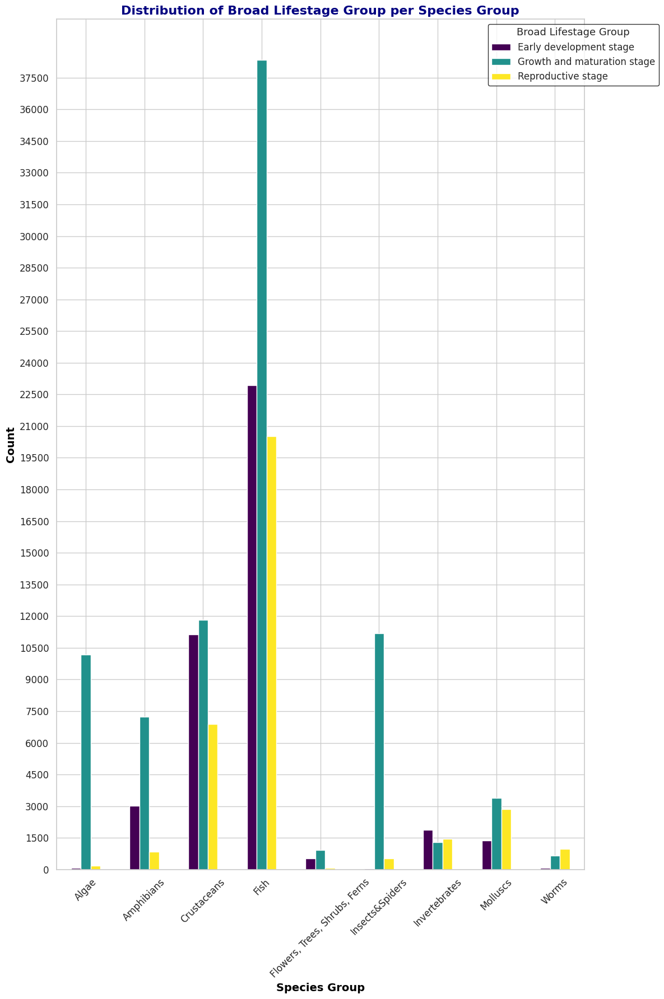

In [ ]:
# Group by 'Species Group' and 'Broad Lifestage Group', and use size() to create a count column
df_grouped = df_life_stage.groupby(['Species Group', 'Broad Lifestage Group']).size().reset_index(name='Count')

# Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Species Group' as columns, and their counts as values
pivot_df = df_grouped.pivot(index='Species Group', columns='Broad Lifestage Group', values='Count').fillna(0)

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Create the plot
fig, ax = plt.subplots(figsize=(12, 18))
pivot_df.plot(kind='bar', stacked=False, ax=ax, colormap='viridis')  # Using a more visually appealing colormap

# Enhance title and labels
plt.title('Distribution of Broad Lifestage Group per Species Group', fontsize=16, fontweight='bold', color='navy')
plt.xlabel('Species Group', fontsize=14, fontweight='bold', color='black')
plt.ylabel('Count', fontsize=14, fontweight='bold', color='black')

# Improve the ticks for better readability
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12, ticks=np.arange(0, 39000, step=1500))

# Customize the legend
leg = plt.legend(title='Broad Lifestage Group', fontsize=12, title_fontsize='13', loc='upper right', bbox_to_anchor=(1.15, 1))
leg.get_frame().set_edgecolor('black')  # Set legend frame color

# Add grid for better readability
ax.yaxis.grid(True)  # Just add horizontal grid lines

# Tight layout for better spacing
plt.tight_layout()

# Save the plot as a high-resolution PNG file
plt.savefig('species_lifestage_distribution.png', dpi=300)

# Show the plot
plt.show()

In [ ]:
# Calculate the counts of each life stage within each species group
life_stages = df_life_stage.groupby(['Species Group', 'Broad Lifestage Group']).size()

# Structure to hold the data
species_group_data = {}

# Populate the dictionary with species groups and their respective life stages
for (species_group, life_stage), count in life_stages.items():
    if species_group not in species_group_data:
        species_group_data[species_group] = {}
    species_group_data[species_group][life_stage] = count

# Printing each species group and the counts of each life stage
for species_group, life_stages in species_group_data.items():
    print(f"Species Group: {species_group}")
    for life_stage, count in life_stages.items():
        print(f"  {life_stage}: {count}")
    print()  # for better readability with an extra newline

Species Group: Algae
  Early development stage: 85
  Growth and maturation stage: 10175
  Reproductive stage: 166

Species Group: Amphibians
  Early development stage: 3030
  Growth and maturation stage: 7223
  Reproductive stage: 847

Species Group: Crustaceans
  Early development stage: 11120
  Growth and maturation stage: 11815
  Reproductive stage: 6901

Species Group: Fish
  Early development stage: 22922
  Growth and maturation stage: 38351
  Reproductive stage: 20514

Species Group: Flowers, Trees, Shrubs, Ferns
  Early development stage: 535
  Growth and maturation stage: 921
  Reproductive stage: 68

Species Group: Insects&Spiders
  Early development stage: 37
  Growth and maturation stage: 11197
  Reproductive stage: 517

Species Group: Invertebrates
  Early development stage: 1873
  Growth and maturation stage: 1305
  Reproductive stage: 1456

Species Group: Molluscs
  Early development stage: 1374
  Growth and maturation stage: 3397
  Reproductive stage: 2859

Species Group

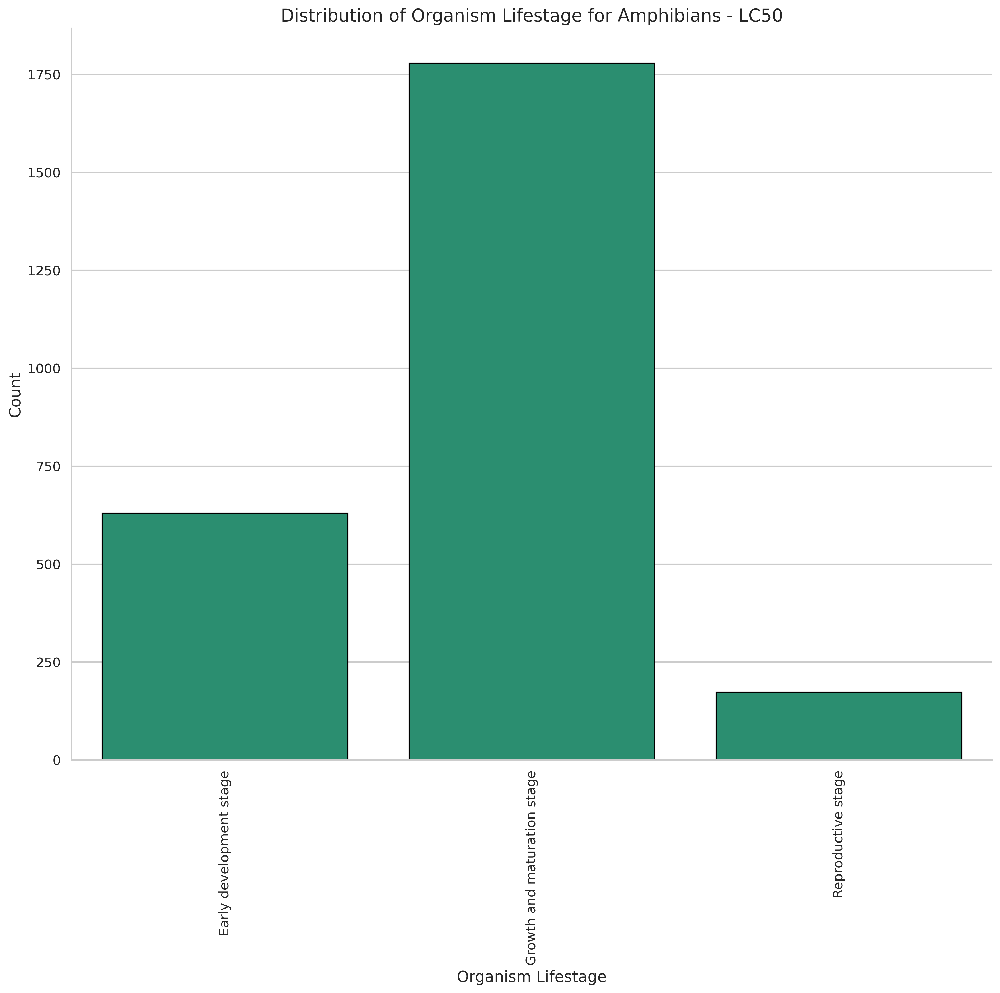

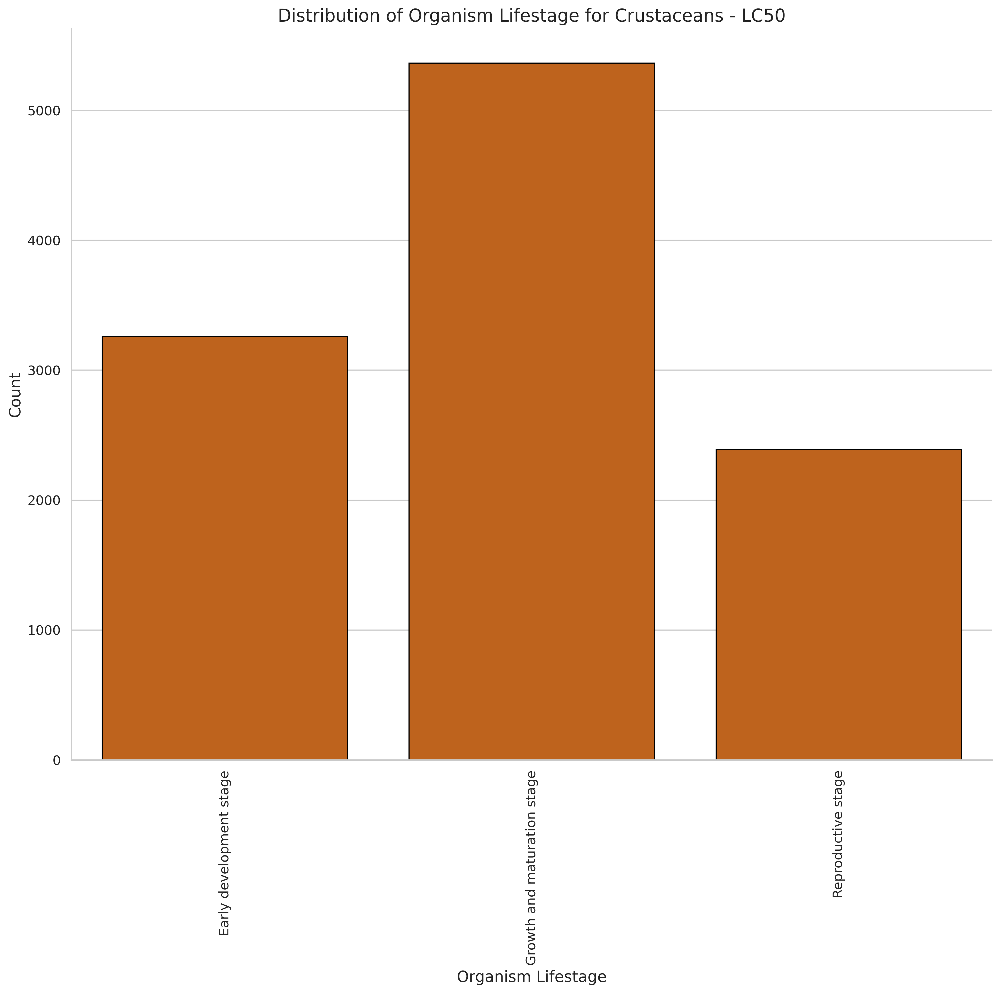

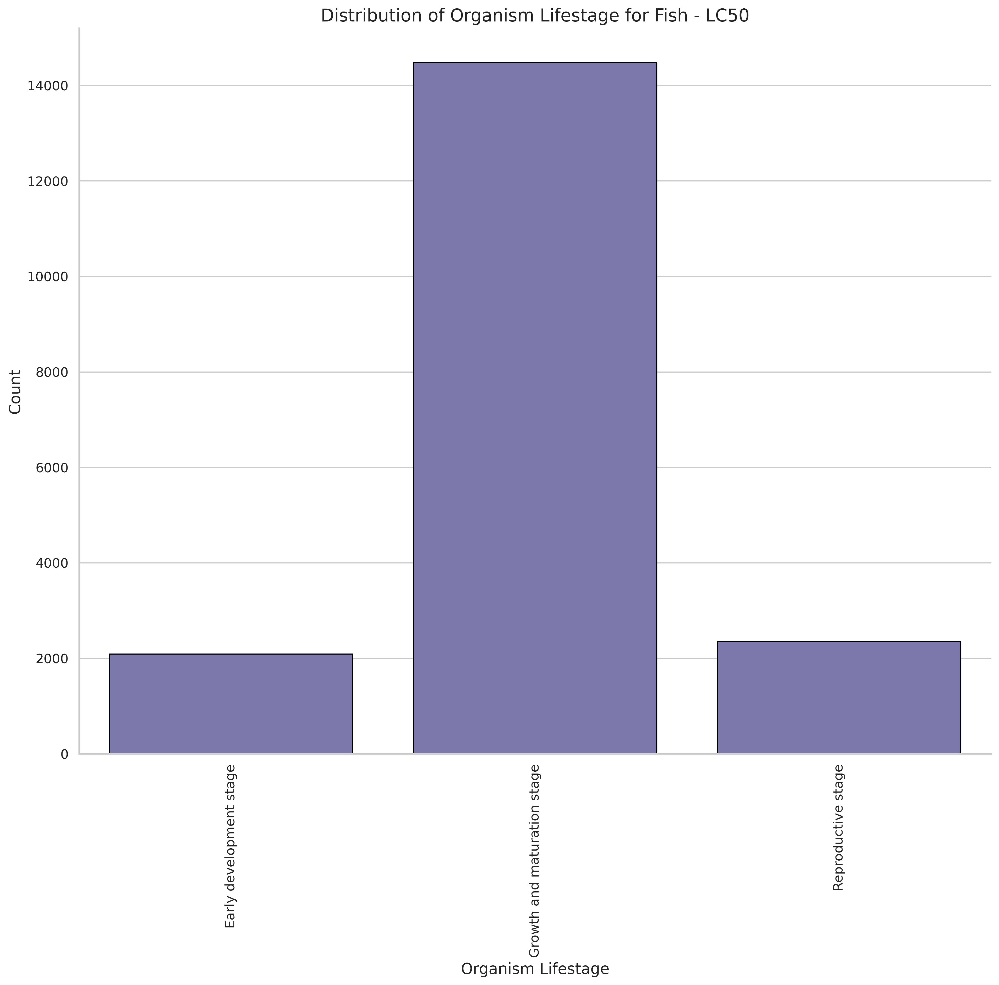

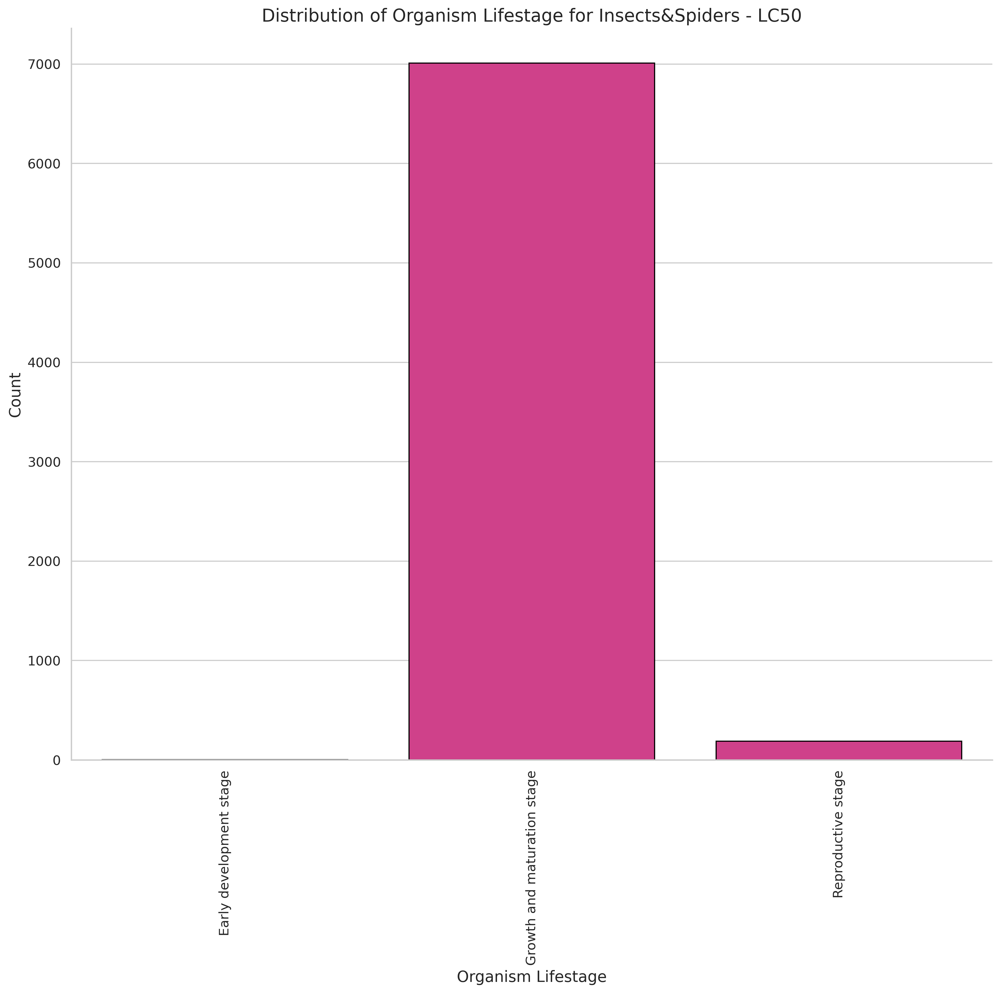

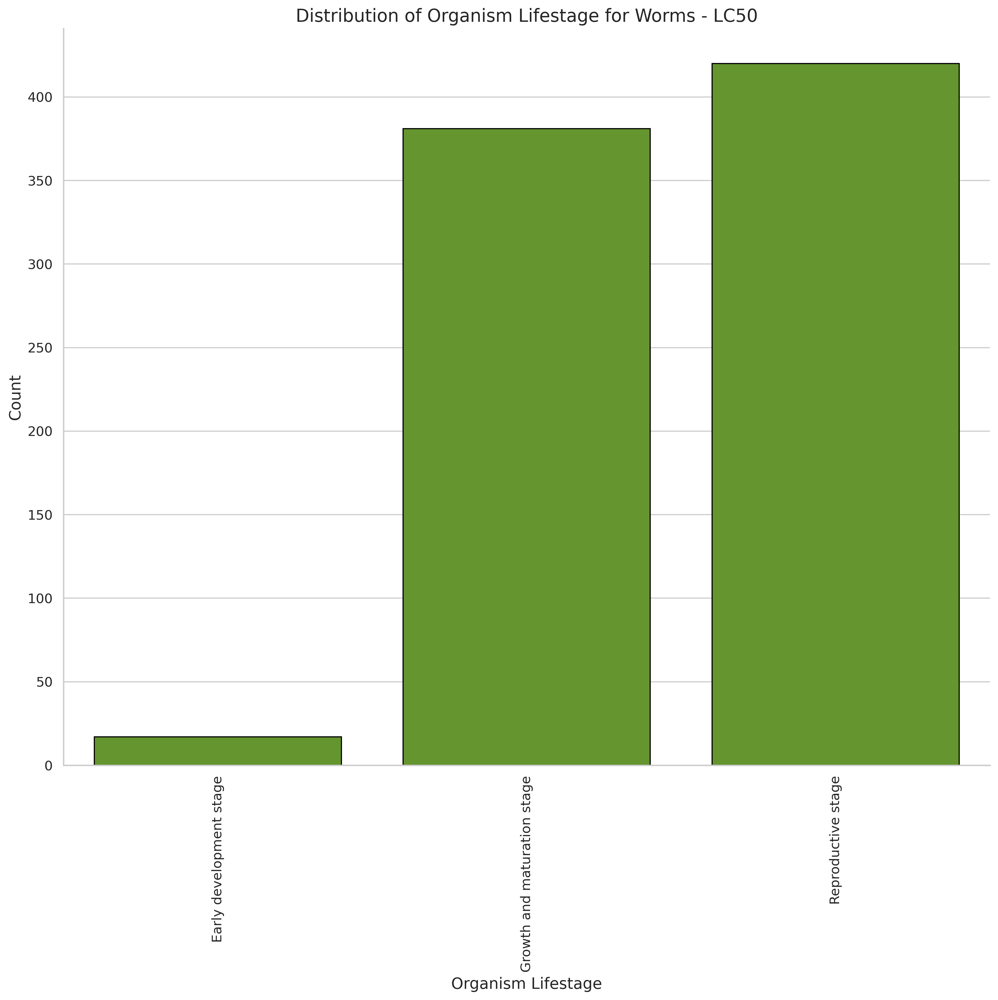

...

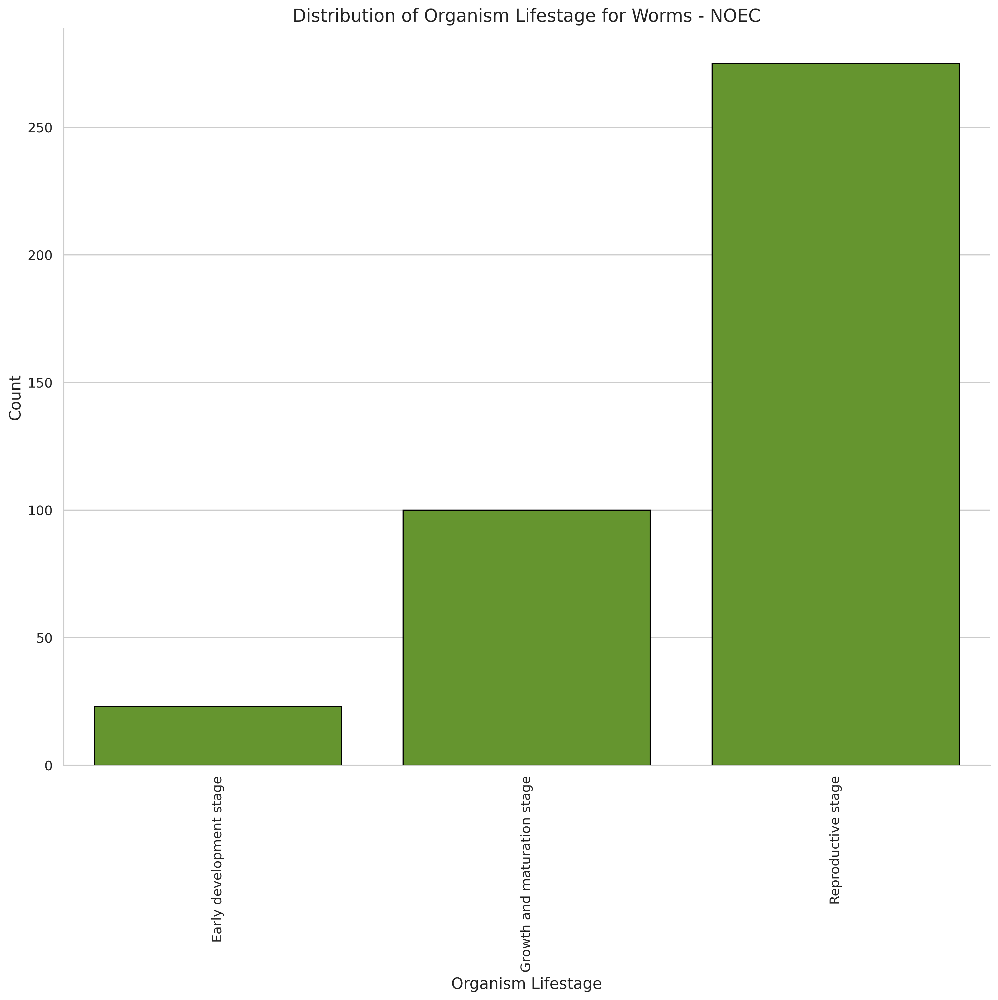

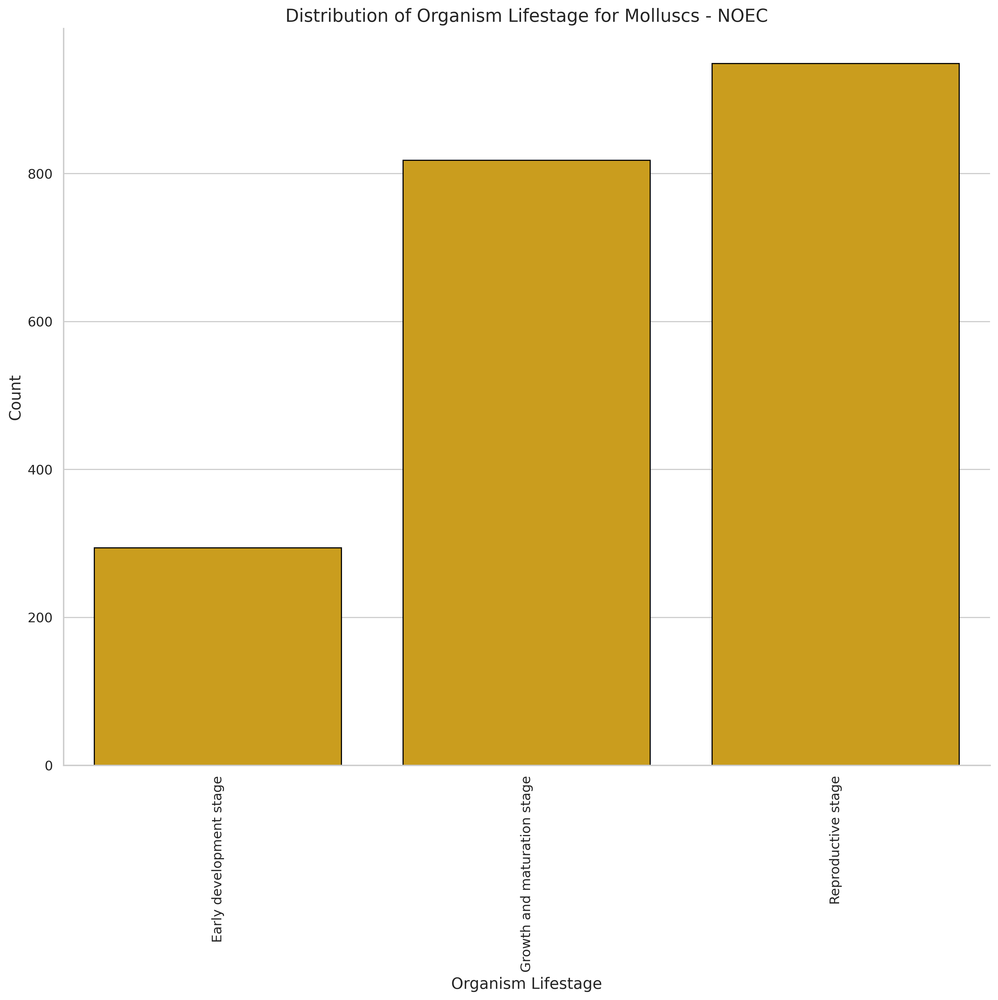

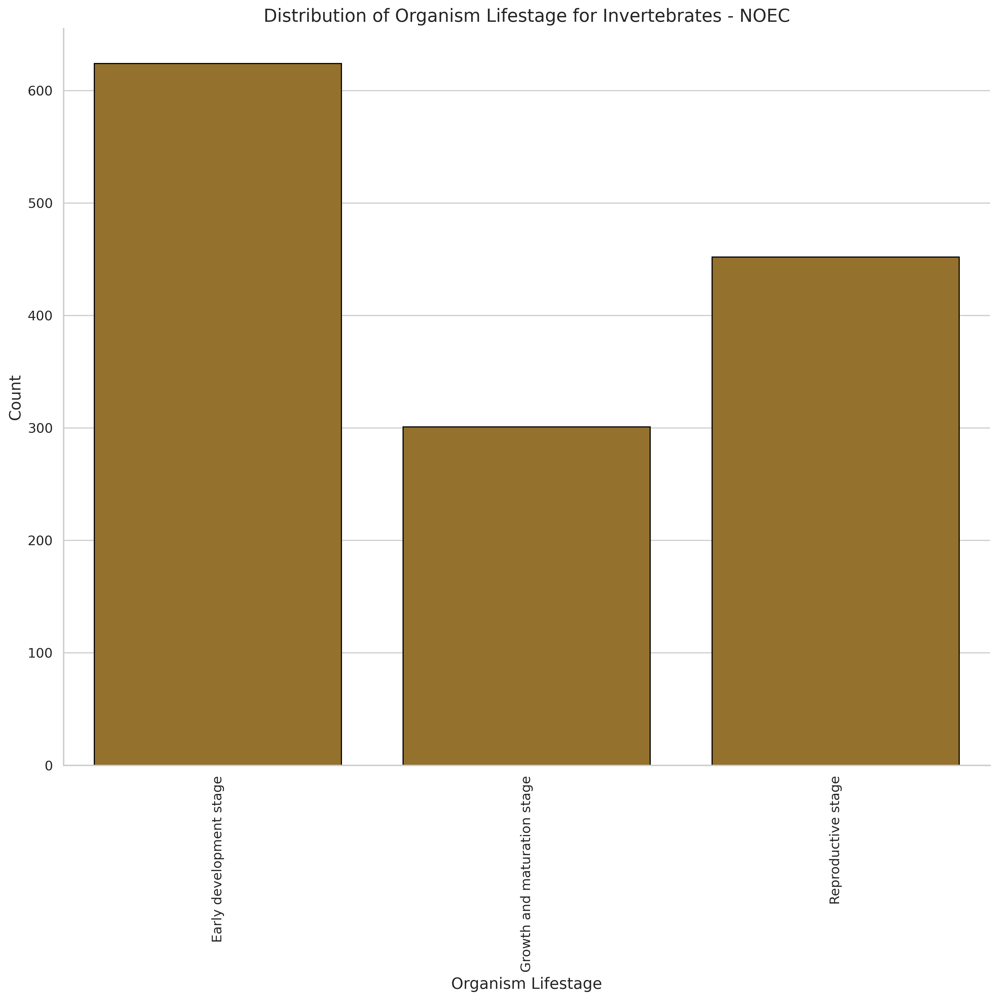

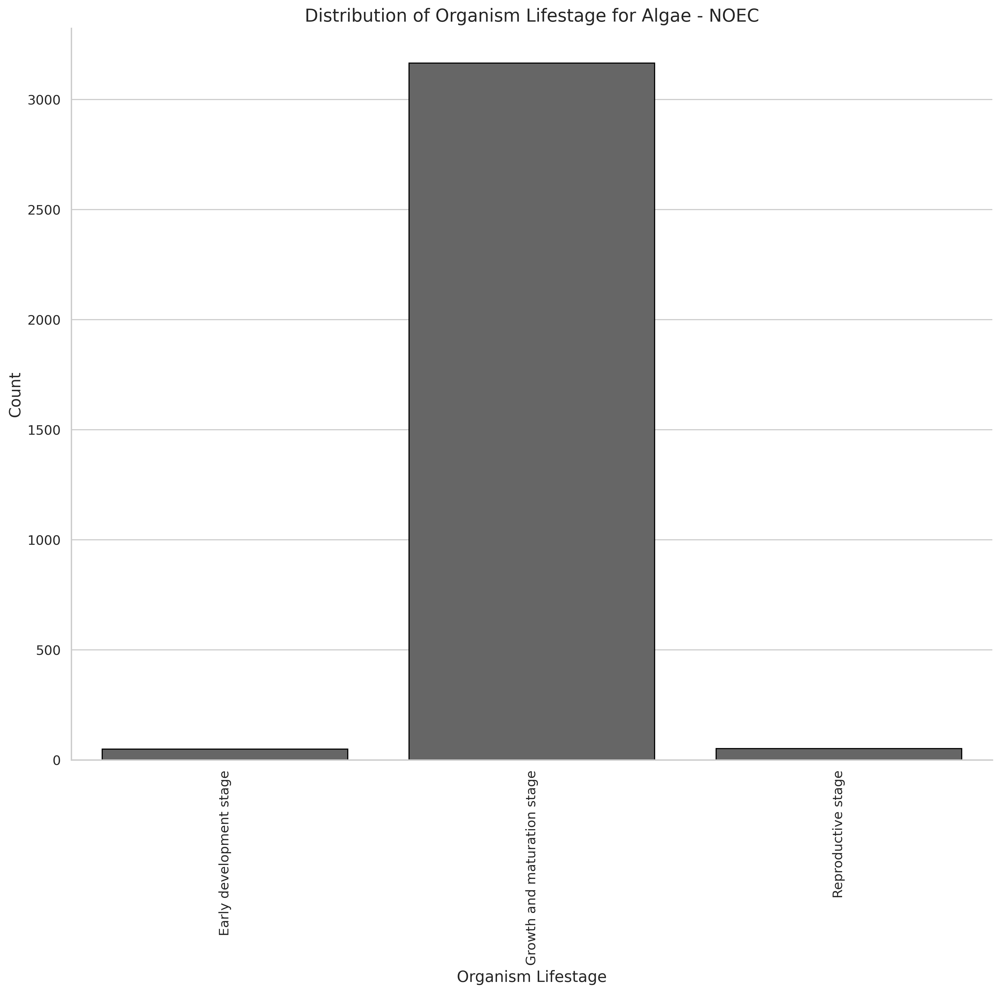

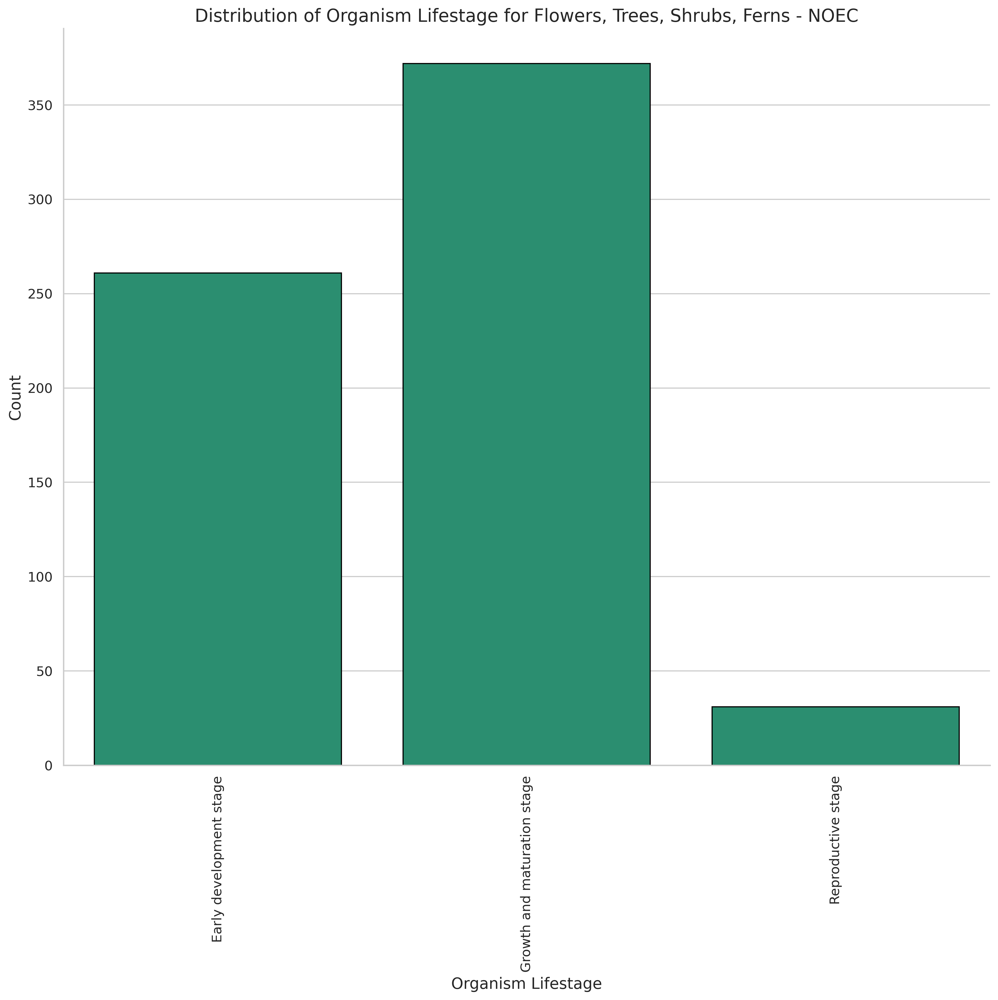

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Ensure the color palette includes all unique species common names
species_common_names = df_life_stage['Species Group'].unique()
palette = sns.color_palette("Dark2", n_colors=len(species_common_names))
color_map = {species: color for species, color in zip(species_common_names, palette)}

# Get all unique endpoints from df_life_stage
endpoints = df_life_stage['Endpoint'].unique()

# Iterate through each endpoint type
for endpoint in endpoints:
    # Filter data for the current endpoint
    df_endpoint = df_life_stage[df_life_stage['Endpoint'] == endpoint]

    # Get unique species for the current endpoint
    species_in_endpoint = df_endpoint['Species Group'].unique()

    for species in species_in_endpoint:
        # Filter data for the current species within the current endpoint
        df_species = df_endpoint[df_endpoint['Species Group'] == species]

        # Check if 'Organism Lifestage' has any data
        if 'Organism Lifestage' in df_species.columns and not df_species['Broad Lifestage Group'].isna().all():
            # Group data by 'Organism Lifestage' and count occurrences
            lifestage_counts = df_species['Broad Lifestage Group'].value_counts().sort_index()

            # Create the bar plot with a consistent color map if there are any lifestages
            if not lifestage_counts.empty:
                plt.figure(figsize=(15, 12), dpi=300)
                plt.tight_layout()  # Adjust layout to make room for labels
                ax = sns.barplot(x=lifestage_counts.index, y=lifestage_counts.values, color=color_map.get(species, 'gray'), edgecolor='black')

                # Customizing the plot
                ax.set_title(f'Distribution of Organism Lifestage for {species} - {endpoint}', fontsize=16)
                ax.set_xlabel('Organism Lifestage', fontsize=14)
                ax.set_ylabel('Count', fontsize=14)
                ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
                ax.xaxis.set_tick_params(labelsize=12)
                ax.yaxis.set_tick_params(labelsize=12)

                # Remove unnecessary spines
                sns.despine()

                # Save each plot as a high-resolution PNG file
                plt.savefig(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Figures/LifeStageData-lifestage_distribution_{species}_{endpoint}.png', dpi=300, bbox_inches='tight')

                # Show the plot
                plt.show()


In [ ]:
# Get unique species from the 'Species Group' column
species_groups = df_life_stage['Species Group'].unique()

# Create an empty dictionary to store DataFrame for each species
species_pivot_tables = {}

for species in species_groups:
    # Filter DataFrame for the current species
    df_species = df_life_stage[df_life_stage['Species Group'] == species]

    # Group by 'Endpoint' and 'Broad Lifestage Group' and count the occurrences
    endpoint_lifestage_counts = df_species.groupby(['Endpoint', 'Broad Lifestage Group']).size()

    # Reset the index to turn the results into a DataFrame
    endpoint_lifestage_counts_df = endpoint_lifestage_counts.reset_index(name='Count')

    # Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Endpoint' as columns, and 'Count' as cell values
    pivoted_df = endpoint_lifestage_counts_df.pivot(index='Broad Lifestage Group', columns='Endpoint', values='Count')

    if len(pivoted_df) > 0:
        # Store the pivoted DataFrame in the dictionary using the species name as the key
        species_pivot_tables[species] = pivoted_df

        # Optionally print the pivoted DataFrame
        print(f"Data Distribution for {species}:")
        print(pivoted_df, "\n")
        pivoted_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Stats/LifeStageData_distribution_{species}.csv')

In [ ]:
df_life_stage

In [ ]:
df_life_stage.to_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/1.LifeStageData-LifeSatgeGroupsProcessed.csv', index=False)

# Concentration Units Standardisation

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df_life_stage = pd.read_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/1.LifeStageData-LifeSatgeGroupsProcessed.csv')

In [ ]:
df_life_stage[['Conc 1 Units (Standardized)', 'Media Type']].value_counts().to_dict()

{('AI mg/L', 'Fresh water'): 117258,
 ('AI mg/L', 'Salt water'): 24913,
 ('AI mg/L', 'Culture'): 10524,
 ('AI mg/kg bdwt', 'Fresh water'): 2981,
 ('AI mg/kg food', 'Fresh water'): 2637,
 ('ul/L', 'Fresh water'): 1183,
 ('%', 'Fresh water'): 803,
 ('ae mg/L', 'Fresh water'): 789,
 ('AI mg/kg bdwt', 'Salt water'): 789,
 ('% v/v', 'Fresh water'): 479,
 ('mg/L', 'Culture'): 442,
 ('ug/L', 'Culture'): 429,
 ('AI mg/kg food', 'Salt water'): 365,
 ('ug/ml', 'Culture'): 258,
 ('ml/L', 'Fresh water'): 237,
 ('%', 'Salt water'): 214,
 ('mg/L', 'Fresh water'): 172,
 ('AI lb/acre', 'Fresh water'): 162,
 ('%', 'Culture'): 156,
 ('ng/ml', 'Culture'): 147,
 ('uM', 'Fresh water'): 145,
 ('ul/L', 'Salt water'): 140,
 ('mg/g diet', 'Fresh water'): 99,
 ('AI mg/kg bdwt', 'Culture'): 95,
 ('AI ul/L', 'Fresh water'): 89,
 ('ppm', 'Culture'): 84,
 ('ae mg/L', 'Salt water'): 82,
 ('AI g/ha', 'Fresh water'): 81,
 ('% v/v', 'Salt water'): 79,
 ('AI ug/L', 'Culture'): 78,
 ('ml/L', 'Salt water'): 78,
 ('% of di

In [ ]:
conc_units = df_life_stage['Conc 1 Units (Standardized)'].value_counts().to_dict()
for key, value in conc_units.items():
    print(key, ':   ', value)

AI mg/L :    152695
AI mg/kg bdwt :    3865
AI mg/kg food :    3002
ul/L :    1348
% :    1173
ae mg/L :    895
mg/L :    626
% v/v :    609
ug/L :    451
ml/L :    319
ug/ml :    311
uM :    208
AI lb/acre :    162
ng/ml :    147
% of diet :    122
mg/g diet :    100
ppm :    90
AI ul/L :    89
AI g/ha :    81
pg/g egg :    81
AI ug/L :    78
ug/g wet wt diet :    61
mmol/kg :    57
mM :    45
fibers/L :    42
umol/L :    41
ug/g lipid diet :    40
umol/ml :    38
ug/cm2 :    35
ng/egg :    32
ml :    31
% dry wght :    31
M :    27
ug/2 org/d :    26
% w/v :    25
ppm wet wt diet :    22
mol/g bdwt :    21
mg/ml :    21
ppb :    20
ng :    20
mg/ml diet :    20
kg/ha :    20
ug :    20
IU :    18
% vol :    17
ae ppb :    17
lb/acre :    17
ug/org :    16
L/ha :    16
ul :    16
pmol/g bdwt :    15
ug/100 ml :    15
AI g/m2 :    15
umol/g :    15
nmol/g diet :    15
ug/10 L :    14
mg :    14
nmol/kg/mi :    14
nM :    13
umol/kg :    13
% of bdwt :    13
pmol/cell :    12
% sat :   

In [ ]:
import requests
import pandas as pd

# Function to retrieve molecular weight (molar mass) using PubChem API
def get_chemical_properties(cas_number):
    url = f"https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/name/{cas_number}/JSON"
    response = requests.get(url)
    if response.status_code == 200:
        data = response.json()
        if 'PC_Compounds' in data and len(data['PC_Compounds']) > 0:
            cid = data['PC_Compounds'][0]['id']['id']['cid']
            prop_url = f"https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/cid/{cid}/property/MolecularWeight/JSON"
            prop_response = requests.get(prop_url)
            if prop_response.status_code == 200:
                prop_data = prop_response.json()
                return prop_data['PropertyTable']['Properties'][0]['MolecularWeight']
    return None

# Conversion function
def convert_to_standard(value, unit, cas_number=None):
    if unit in ['AI mg/L', 'mg/L', 'ae mg/L']:
        return value, 'mg/L'  # Already in mg/L
    elif unit == 'ul/L':
        return value, 'mg/L'  # Assuming 1 ul = 1 mg for water
    elif unit == '%':
        return value * 10000, 'mg/L'  # Convert % to mg/L
    elif unit == 'ug/L':
        return value / 1000, 'mg/L'  # Convert ug/L to mg/L
    elif unit == 'ug/ml':
        return value, 'mg/L'  # Convert ug/ml to mg/L
    elif unit == 'uM':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass / 1000, 'mg/L'  # Convert uM to mg/L
    elif unit == 'ng/ml':
        return value / 1000, 'mg/L'  # Convert ng/ml to mg/L
    elif unit == 'ppm':
        return value, 'mg/L'  # ppm is approximately mg/L
    elif unit == 'pg/g egg':
        return value * 1e-9, 'mg/L'  # Convert pg/g egg to mg/L
    elif unit == 'AI ug/L':
        return value / 1000, 'mg/L'  # Convert AI ug/L to mg/L
    elif unit == 'ug/g wet wt diet':
        return value / 1000, 'mg/L'  # Convert ug/g wet wt diet to mg/L
    elif unit == 'mmol/kg':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass * 1000, 'mg/L'  # Convert mmol/kg to mg/L
    elif unit == 'mM':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass, 'mg/L'  # Convert mM to mg/L
    elif unit == 'umol/L':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass * 0.001, 'mg/L'  # Convert umol/L to mg/L
    elif unit == 'ug/g lipid diet':
        return value / 1000, 'mg/L'  # Convert ug/g lipid diet to mg/L
    elif unit == 'umol/ml':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass, 'mg/L'  # Convert umol/ml to mg/L
    elif unit == '% dry wght':
        return value * 10, 'mg/L'  # Convert % dry weight to mg/L
    elif unit == 'M':
        molar_mass = get_chemical_properties(cas_number)
        if molar_mass is None:
            return value, unit  # Return original if molar mass not found
        else:
            return value * molar_mass * 1000, 'mg/L'  # Convert M to mg/L
    elif unit == '% w/v':
        return value * 10000, 'mg/L'  # Convert % w/v to mg/L
    else:
        return value, unit  # For unspecified conversions


# Apply conversions
df_life_stage[['Conc 1 Mean (Standardized)', 'Conc 1 Units (Standardized)']] = df_life_stage.apply(
    lambda row: pd.Series(convert_to_standard(row['Conc 1 Mean (Standardized)'], row['Conc 1 Units (Standardized)'], row['CAS Number'])),
    axis=1
)

In [ ]:
filtered_df = df_life_stage[df_life_stage['Conc 1 Units (Standardized)'] == 'mg/L']
filtered_df

,CAS Number,Chemical Name,Species Scientific Name,Species Common Name,Species Group,Organism Lifestage,Observed Duration Mean (Days),Exposure Type,Media Type,Conc 1 Mean (Standardized),Conc 1 Units (Standardized),Effect,Effect Measurement,Endpoint,Broad Lifestage Group
0,50000,Formaldehyde,Lithobates catesbeianus,American Bullfrog,Amphibians,Tadpole,4.0,Renewal,Fresh water,10.530000,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
1,50180,"N,N-Bis(2-chloroethyl)tetrahydro-2H-1,3,2-oxaz...",Xenopus laevis,African Clawed Frog,Amphibians,Embryo,4.0,Renewal,Fresh water,6760.000000,mg/L,Mortality,Mortality,LC50,Early development stage
2,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.517198,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
3,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.242087,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
4,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates sylvaticus,Wood Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,0.680968,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167748,104206828,"2-[4-(Methylsulfonyl)-2-nitrobenzoyl]-1,3-cycl...",Hydrilla verticillata,Hydrilla,"Flowers, Trees, Shrubs, Ferns",Shoot,14.0,Aquatic - not reported,Fresh water,0.012400,mg/L,Biochemistry,Phytoene,EC50,Growth and maturation stage
167753,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Renewal,Fresh water,0.000460,mg/L,Population,Biomass,EC50,Growth and maturation stage
167754,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Static,Fresh water,0.000920,mg/L,Population,Biomass,EC50,Growth and maturation stage
167755,144740534,"2-[[[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbo...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Static,Fresh water,0.000680,mg/L,Population,Biomass,EC50,Growth and maturation stage


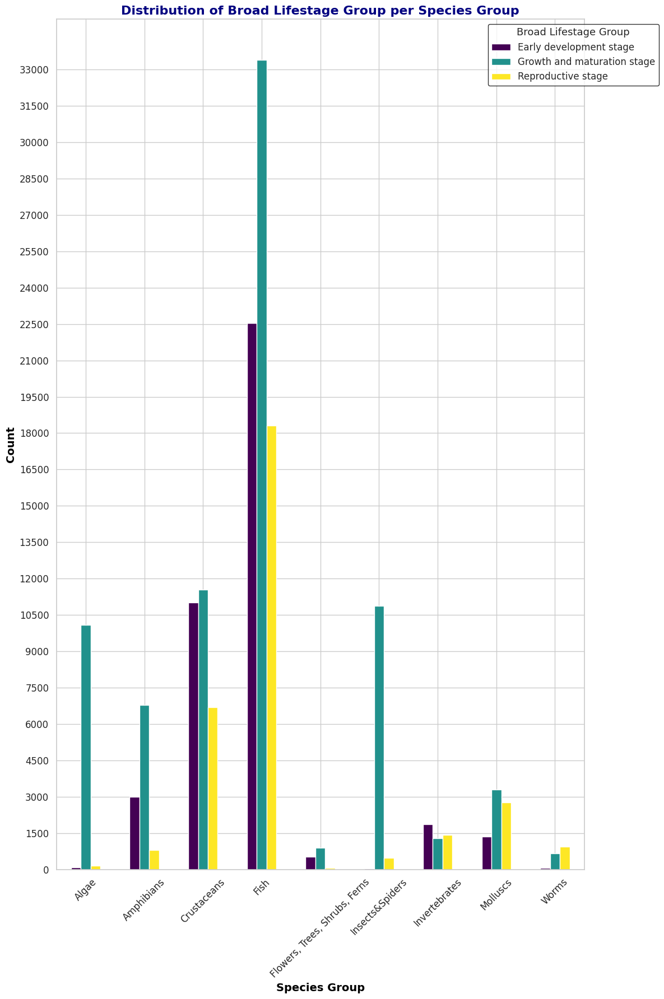

In [ ]:
# Group by 'Species Group' and 'Broad Lifestage Group', and use size() to create a count column
df_grouped = filtered_df.groupby(['Species Group', 'Broad Lifestage Group']).size().reset_index(name='Count')

# Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Species Group' as columns, and their counts as values
pivot_df = df_grouped.pivot(index='Species Group', columns='Broad Lifestage Group', values='Count').fillna(0)

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Create the plot
fig, ax = plt.subplots(figsize=(12, 18))
pivot_df.plot(kind='bar', stacked=False, ax=ax, colormap='viridis')  # Using a more visually appealing colormap

# Enhance title and labels
plt.title('Distribution of Broad Lifestage Group per Species Group', fontsize=16, fontweight='bold', color='navy')
plt.xlabel('Species Group', fontsize=14, fontweight='bold', color='black')
plt.ylabel('Count', fontsize=14, fontweight='bold', color='black')

# Improve the ticks for better readability
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12, ticks=np.arange(0, 34000, step=1500))

# Customize the legend
leg = plt.legend(title='Broad Lifestage Group', fontsize=12, title_fontsize='13', loc='upper right', bbox_to_anchor=(1.15, 1))
leg.get_frame().set_edgecolor('black')  # Set legend frame color

# Add grid for better readability
ax.yaxis.grid(True)  # Just add horizontal grid lines

# Tight layout for better spacing
plt.tight_layout()

# Save the plot as a high-resolution PNG file
plt.savefig('species_lifestage_distribution.png', dpi=300)

# Show the plot
plt.show()

In [ ]:
conc_units = df_life_stage['Conc 1 Units (Standardized)'].value_counts().to_dict()
for key, value in conc_units.items():
    print(key, ':   ', value)

mg/L :    150984
AI mg/kg bdwt :    3859
AI mg/kg food :    2981
% v/v :    568
ml/L :    317
AI lb/acre :    162
uM :    151
% of diet :    122
mg/g diet :    100
AI ul/L :    89
AI g/ha :    68
mmol/kg :    57
fibers/L :    42
umol/L :    39
mM :    35
ug/cm2 :    35
ng/egg :    32
ml :    29
ug/2 org/d :    26
ppm wet wt diet :    22
mol/g bdwt :    21
ug :    20
ng :    20
mg/ml diet :    20
IU :    18
lb/acre :    17
ae ppb :    17
ug/org :    16
L/ha :    16
nmol/g diet :    15
ug/100 ml :    15
pmol/g bdwt :    15
umol/g :    15
AI g/m2 :    15
ul :    14
ppb :    14
nmol/kg/mi :    14
ug/10 L :    14
umol/kg :    13
nM :    13
% of bdwt :    13
mg :    12
pmol/cell :    12
kg/ha :    12
M :    11
% sat :    11
ug/disk :    10
mg/eu :    10
umol/kg/mi :    10
um :    10
umol/g org :    9
ae ppm :    9
ml/m3 :    9
AI kg/ha :    9
uL/100 L :    9
ul/ml :    9
uCi/ml :    9
ng eq/ml :    8
0/00 v/v :    8
nmol/g :    8
fg/org :    8
g/d/org :    8
% soln :    8
mg/m3 :    7
ml/g b

In [ ]:
conc_units = filtered_df['Conc 1 Units (Standardized)'].value_counts().to_dict()
for key, value in conc_units.items():
    print(key, ':   ', value)

mg/L :    150984


In [ ]:
import pandas as pd

# Assuming df_life_stage is already loaded and contains the columns 'Species Group', 'Endpoint', 'Broad Lifestage Group'

# Get unique species from the 'Species Group' column
species_groups = filtered_df['Species Group'].unique()

# Create an empty dictionary to store DataFrame for each species
species_pivot_tables = {}

for species in species_groups:
    # Filter DataFrame for the current species
    df_species = filtered_df[filtered_df['Species Group'] == species]

    # Group by 'Endpoint' and 'Broad Lifestage Group' and count the occurrences
    endpoint_lifestage_counts = df_species.groupby(['Endpoint', 'Broad Lifestage Group']).size()

    # Reset the index to turn the results into a DataFrame
    endpoint_lifestage_counts_df = endpoint_lifestage_counts.reset_index(name='Count')

    # Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Endpoint' as columns, and 'Count' as cell values
    pivoted_df = endpoint_lifestage_counts_df.pivot(index='Broad Lifestage Group', columns='Endpoint', values='Count')

    if len(pivoted_df) > 0:
        # Store the pivoted DataFrame in the dictionary using the species name as the key
        species_pivot_tables[species] = pivoted_df

        # Optionally print the pivoted DataFrame
        print(f"Data Distribution for {species}:")
        print(pivoted_df, "\n")
        pivoted_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Stats/LifeStageData_distribution_{species}.csv')

Data Distribution for Amphibians:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage       525   619   792  1064
Growth and maturation stage   119  1759  1926  2989
Reproductive stage             19   173   252   356 

Data Distribution for Crustaceans:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage      2250  3250  2370  3136
Growth and maturation stage  2209  5313  1771  2251
Reproductive stage            841  2389  1539  1915 

Data Distribution for Fish:
Endpoint                     EC50   LC50  LOEC   NOEC
Broad Lifestage Group                                
Early development stage       989   2079  8038  11442
Growth and maturation stage   667  14430  8197  10108
Reproductive stage            216   2343  6571   9175 

Data Distribution for Insects&Spiders:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage 

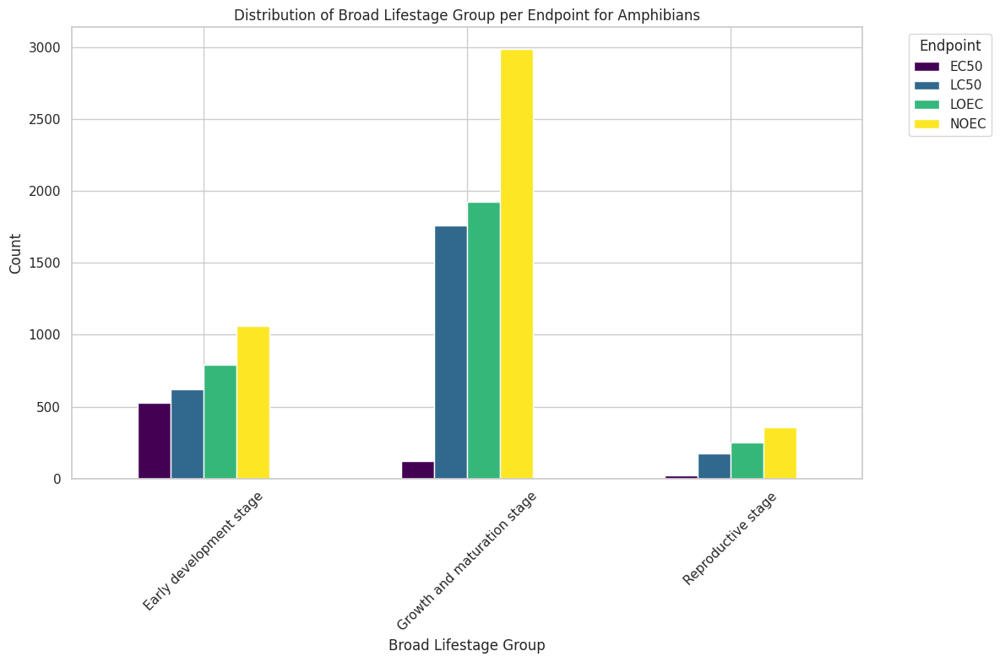

Data Distribution for Amphibians:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage       525   619   792  1064
Growth and maturation stage   119  1759  1926  2989
Reproductive stage             19   173   252   356 



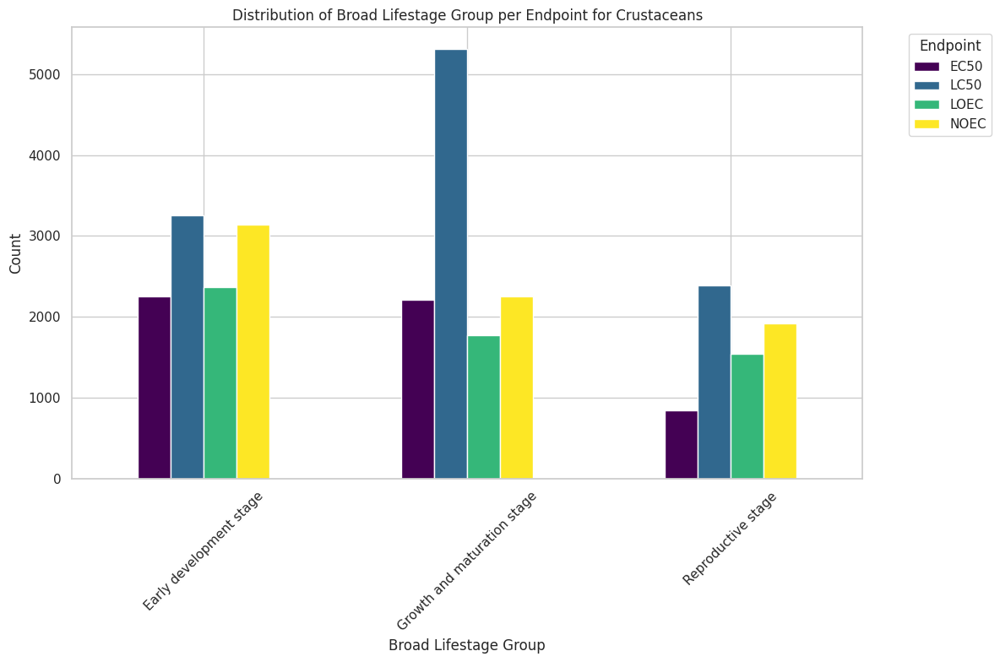

Data Distribution for Crustaceans:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage      2250  3250  2370  3136
Growth and maturation stage  2209  5313  1771  2251
Reproductive stage            841  2389  1539  1915 



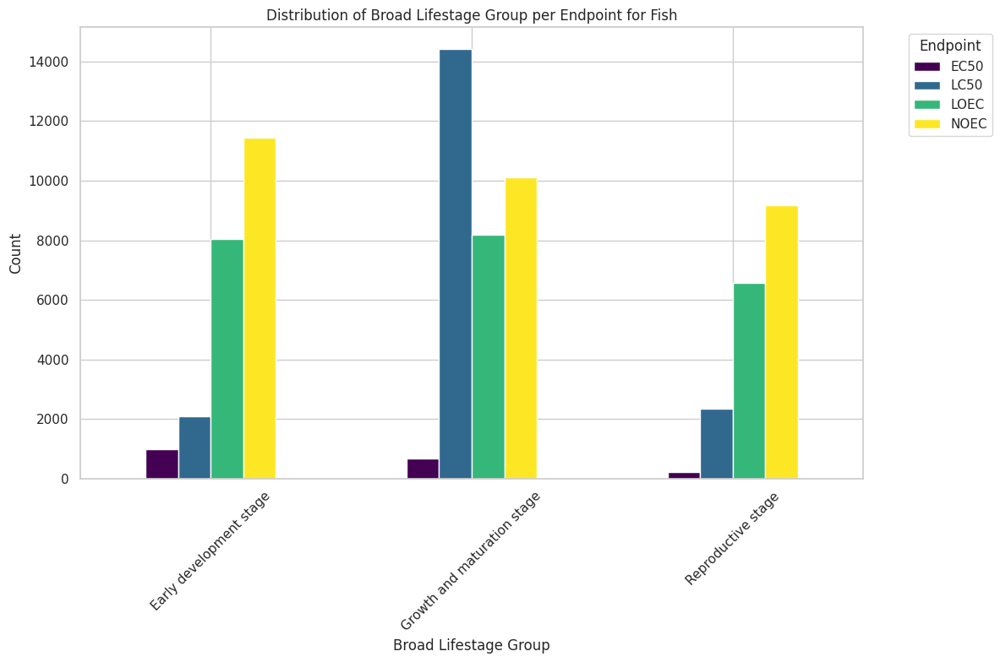

Data Distribution for Fish:
Endpoint                     EC50   LC50  LOEC   NOEC
Broad Lifestage Group                                
Early development stage       989   2079  8038  11442
Growth and maturation stage   667  14430  8197  10108
Reproductive stage            216   2343  6571   9175 



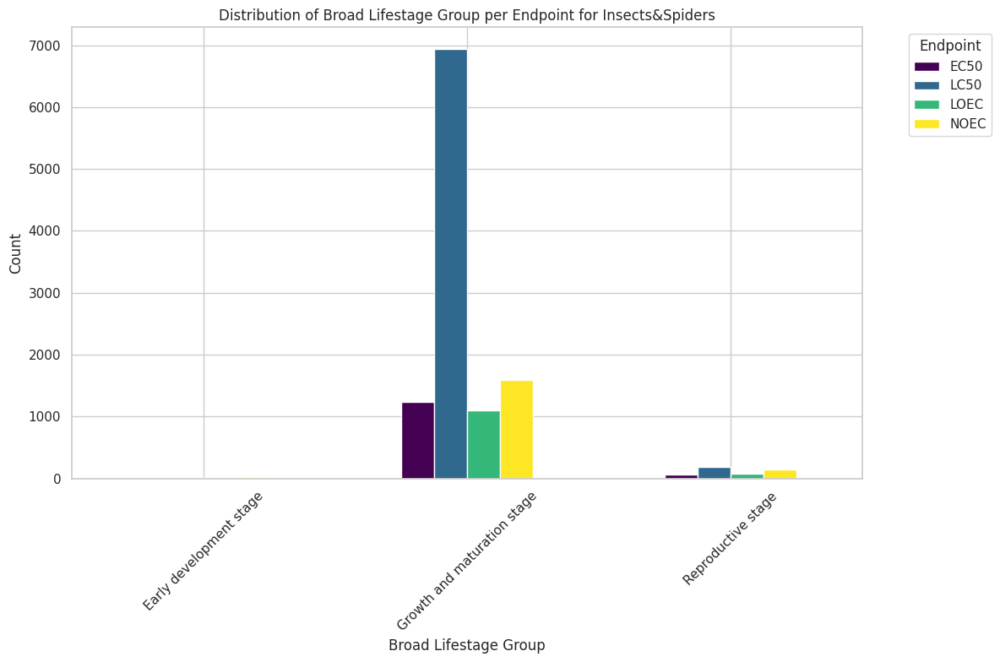

Data Distribution for Insects&Spiders:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage         4     3    13    17
Growth and maturation stage  1238  6942  1101  1591
Reproductive stage             65   189    84   141 



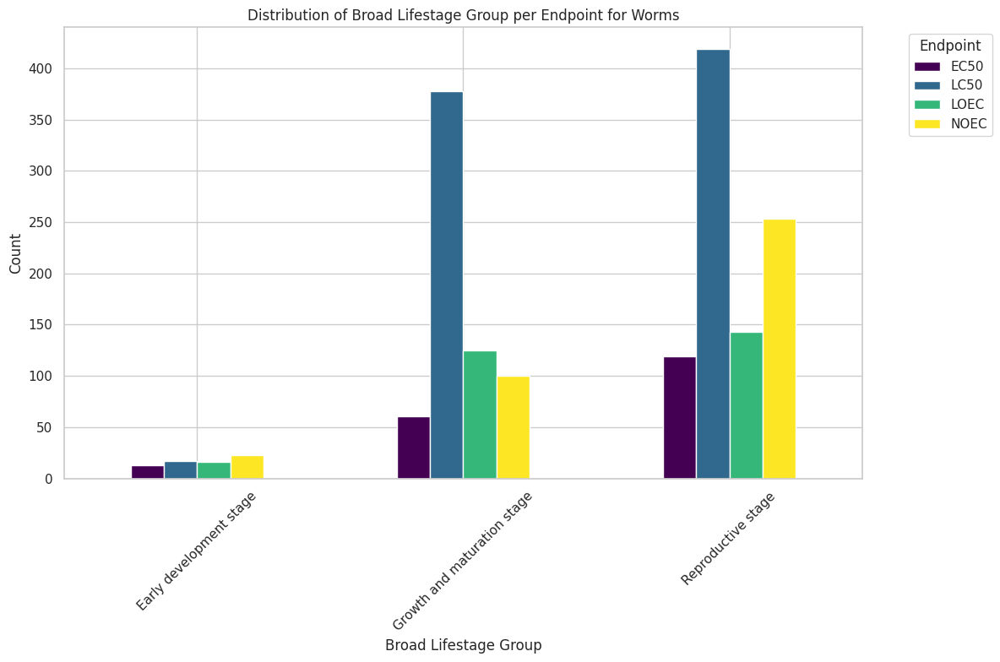

Data Distribution for Worms:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage        13    17    16    23
Growth and maturation stage    61   378   125   100
Reproductive stage            119   419   143   253 



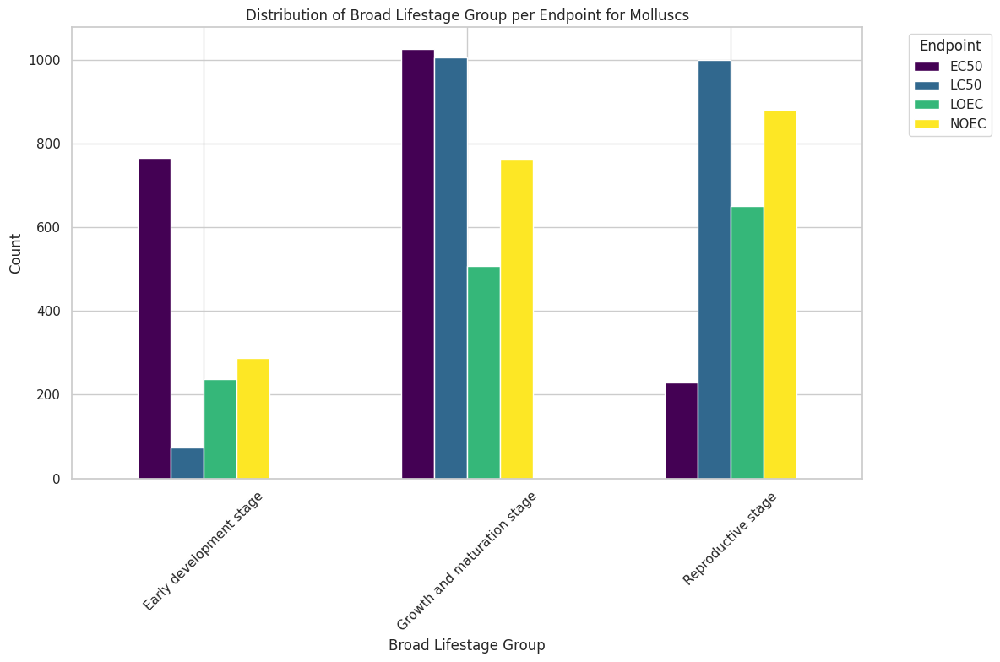

Data Distribution for Molluscs:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage       765    74   238   287
Growth and maturation stage  1026  1005   508   761
Reproductive stage            229  1000   651   881 



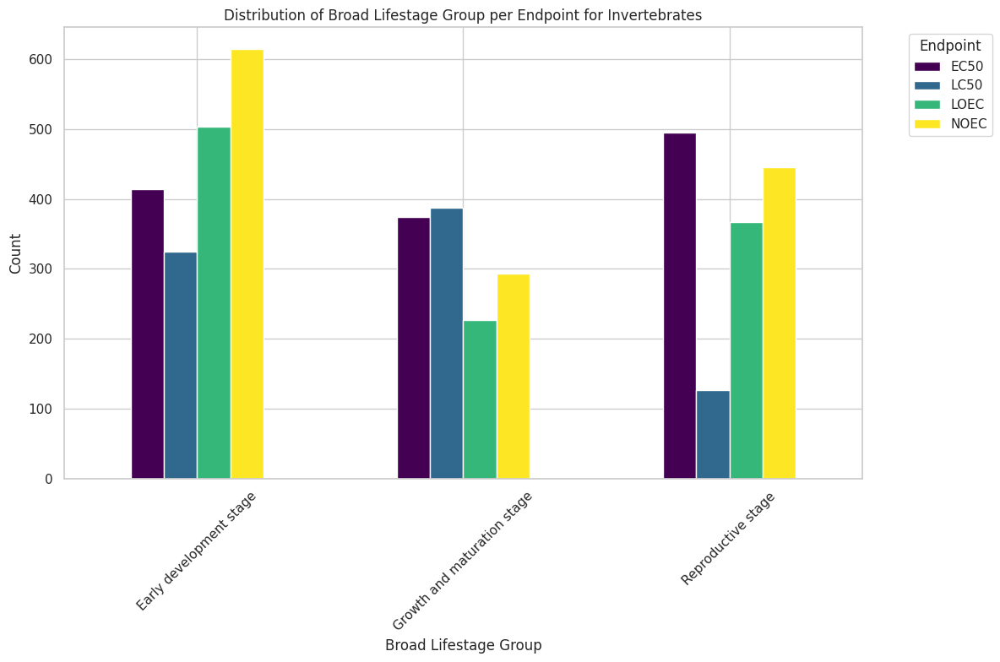

Data Distribution for Invertebrates:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage       414   325   504   615
Growth and maturation stage   374   387   227   293
Reproductive stage            495   127   367   446 



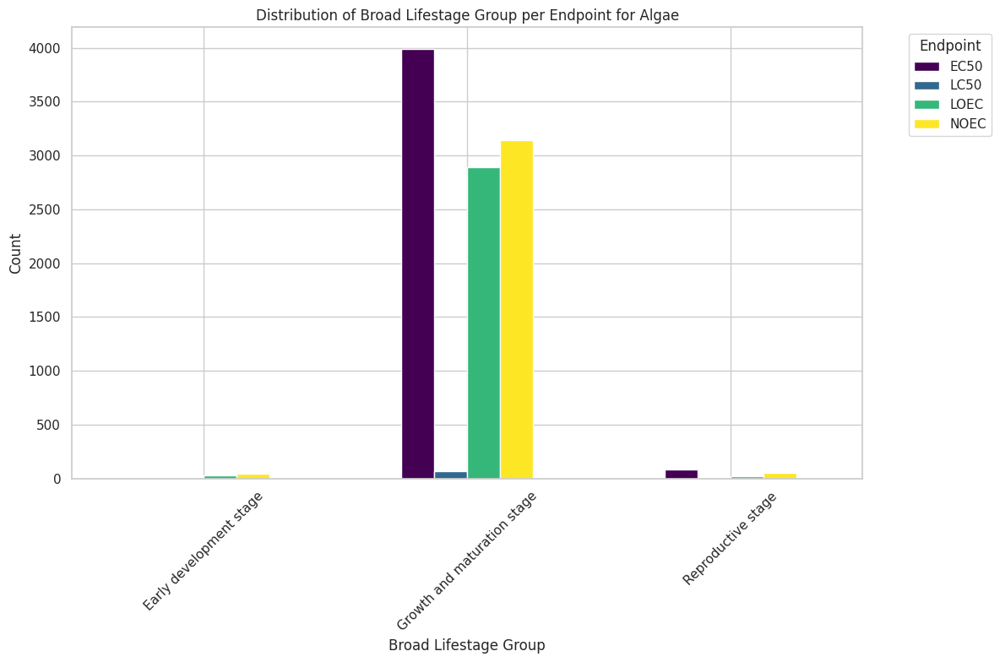

Data Distribution for Algae:
Endpoint                       EC50  LC50    LOEC    NOEC
Broad Lifestage Group                                    
Early development stage         6.0   0.0    29.0    48.0
Growth and maturation stage  3992.0  70.0  2893.0  3143.0
Reproductive stage             86.0   5.0    23.0    50.0 



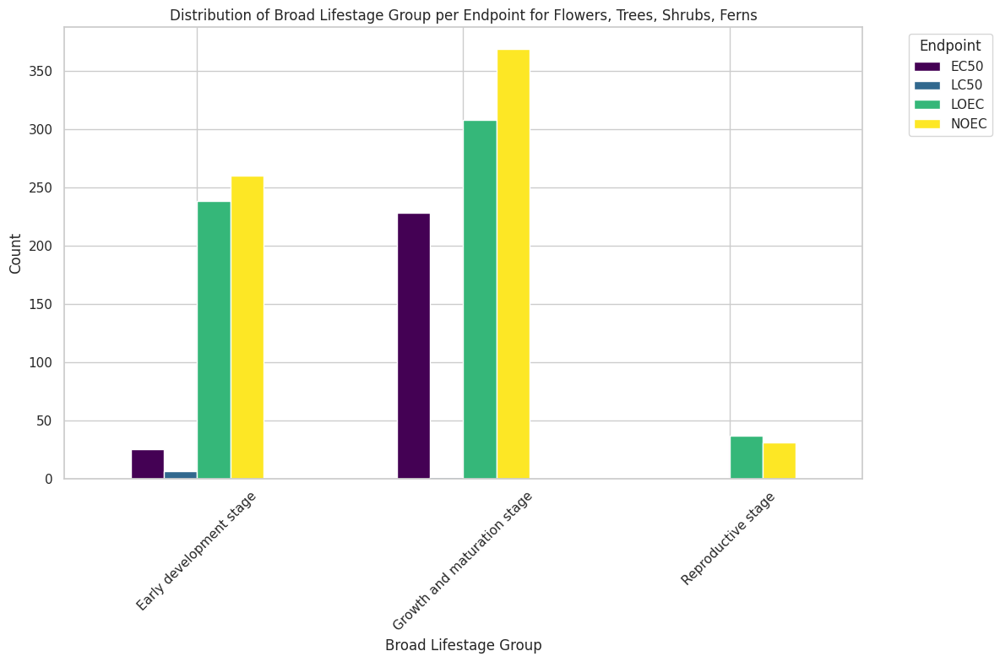

Data Distribution for Flowers, Trees, Shrubs, Ferns:
Endpoint                      EC50  LC50   LOEC   NOEC
Broad Lifestage Group                                 
Early development stage       25.0   6.0  238.0  260.0
Growth and maturation stage  228.0   1.0  308.0  369.0
Reproductive stage             0.0   0.0   37.0   31.0 



In [ ]:
# Get unique species from the 'Species Group' column
species_groups = filtered_df['Species Group'].unique()

# Create an empty dictionary to store DataFrame for each species
species_pivot_tables = {}

for species in species_groups:
    # Filter DataFrame for the current species
    df_species = filtered_df[filtered_df['Species Group'] == species]

    # Group by 'Endpoint' and 'Broad Lifestage Group' and count the occurrences
    endpoint_lifestage_counts = df_species.groupby(['Endpoint', 'Broad Lifestage Group']).size()

    # Reset the index to turn the results into a DataFrame
    endpoint_lifestage_counts_df = endpoint_lifestage_counts.reset_index(name='Count')

    # Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Endpoint' as columns, and 'Count' as cell values
    pivoted_df = endpoint_lifestage_counts_df.pivot(index='Broad Lifestage Group', columns='Endpoint', values='Count').fillna(0)

    if len(pivoted_df) > 0:
        # Store the pivoted DataFrame in the dictionary using the species name as the key
        species_pivot_tables[species] = pivoted_df

        # Plotting the data for the current species
        pivoted_df.plot(kind='bar', stacked=False, figsize=(12, 8), colormap='viridis')

        # Customizing the plot
        plt.title(f'Distribution of Broad Lifestage Group per Endpoint for {species}')
        plt.xlabel('Broad Lifestage Group')
        plt.ylabel('Count')
        plt.xticks(rotation=45)  # Rotate labels to improve readability
        plt.legend(title='Endpoint', bbox_to_anchor=(1.05, 1), loc='upper left')

        # Show and save the plot
        plt.tight_layout()
        plt.savefig(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Figures/LifeStageData_distribution_{species}.png', dpi=300, bbox_inches='tight')
        plt.show()

        # Optionally print the pivoted DataFrame
        print(f"Data Distribution for {species}:")
        print(pivoted_df, "\n")
        pivoted_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Stats/LifeStageData_distribution_{species}.csv')

In [ ]:
filtered_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/2.LifeStageData_UnitsStandardized.csv', index=False)

# Merging Invertebrates in one group (Invertbrates)

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

filtered_df = pd.read_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/2.LifeStageData_UnitsStandardized.csv')

In [ ]:
# List of invertebrate species groups
invertebrates = ['Invertebrates', 'Insects&Spiders', 'Worms', 'Molluscs']

# Update the 'Species Group' column to "Invertebrates" for matching values
filtered_df['Species Group'] = filtered_df['Species Group'].apply(lambda x: 'Other Invertebrates' if x in invertebrates else x)
filtered_df

,CAS Number,Chemical Name,Species Scientific Name,Species Common Name,Species Group,Organism Lifestage,Observed Duration Mean (Days),Exposure Type,Media Type,Conc 1 Mean (Standardized),Conc 1 Units (Standardized),Effect,Effect Measurement,Endpoint,Broad Lifestage Group
0,50000,Formaldehyde,Lithobates catesbeianus,American Bullfrog,Amphibians,Tadpole,4.0,Renewal,Fresh water,10.530000,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
1,50180,"N,N-Bis(2-chloroethyl)tetrahydro-2H-1,3,2-oxaz...",Xenopus laevis,African Clawed Frog,Amphibians,Embryo,4.0,Renewal,Fresh water,6760.000000,mg/L,Mortality,Mortality,LC50,Early development stage
2,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.517198,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
3,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates pipiens,Leopard Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,1.242087,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
4,50282,"(17beta)Estra-1,3,5(10)triene-3,17-diol",Lithobates sylvaticus,Wood Frog,Amphibians,Tadpole,14.0,Renewal,Fresh water,0.680968,mg/L,Mortality,Mortality,LC50,Growth and maturation stage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167748,104206828,"2-[4-(Methylsulfonyl)-2-nitrobenzoyl]-1,3-cycl...",Hydrilla verticillata,Hydrilla,"Flowers, Trees, Shrubs, Ferns",Shoot,14.0,Aquatic - not reported,Fresh water,0.012400,mg/L,Biochemistry,Phytoene,EC50,Growth and maturation stage
167753,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Renewal,Fresh water,0.000460,mg/L,Population,Biomass,EC50,Growth and maturation stage
167754,122931480,"N-[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbony...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Static,Fresh water,0.000920,mg/L,Population,Biomass,EC50,Growth and maturation stage
167755,144740534,"2-[[[[(4,6-Dimethoxy-2-pyrimidinyl)amino]carbo...",Lemna gibba,Inflated Duckweed,"Flowers, Trees, Shrubs, Ferns",Exponential growth phase (log),7.0,Static,Fresh water,0.000680,mg/L,Population,Biomass,EC50,Growth and maturation stage


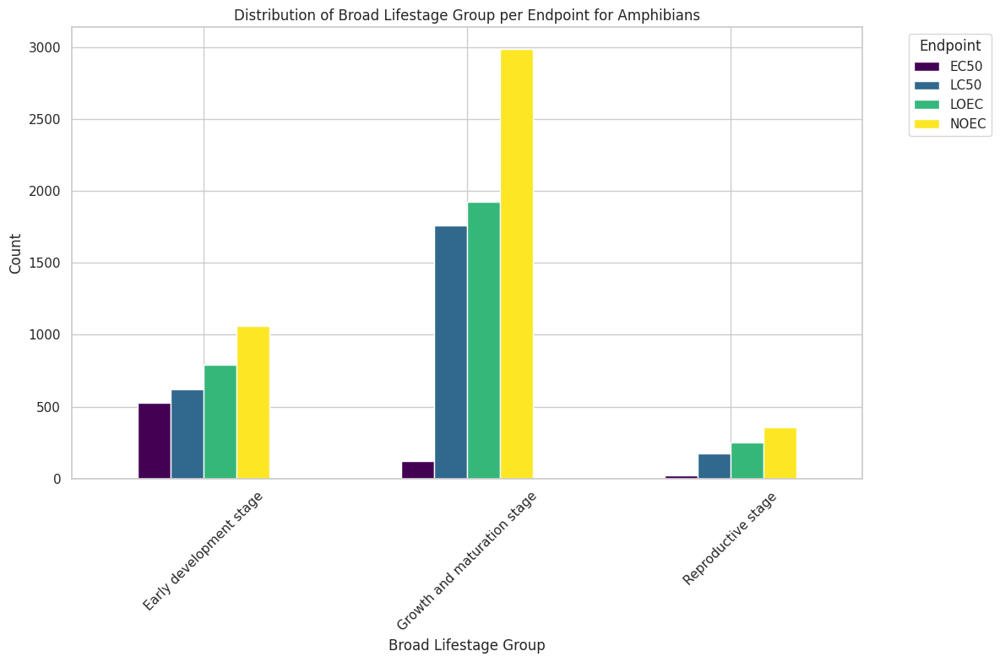

Data Distribution for Amphibians:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage       525   619   792  1064
Growth and maturation stage   119  1759  1926  2989
Reproductive stage             19   173   252   356 



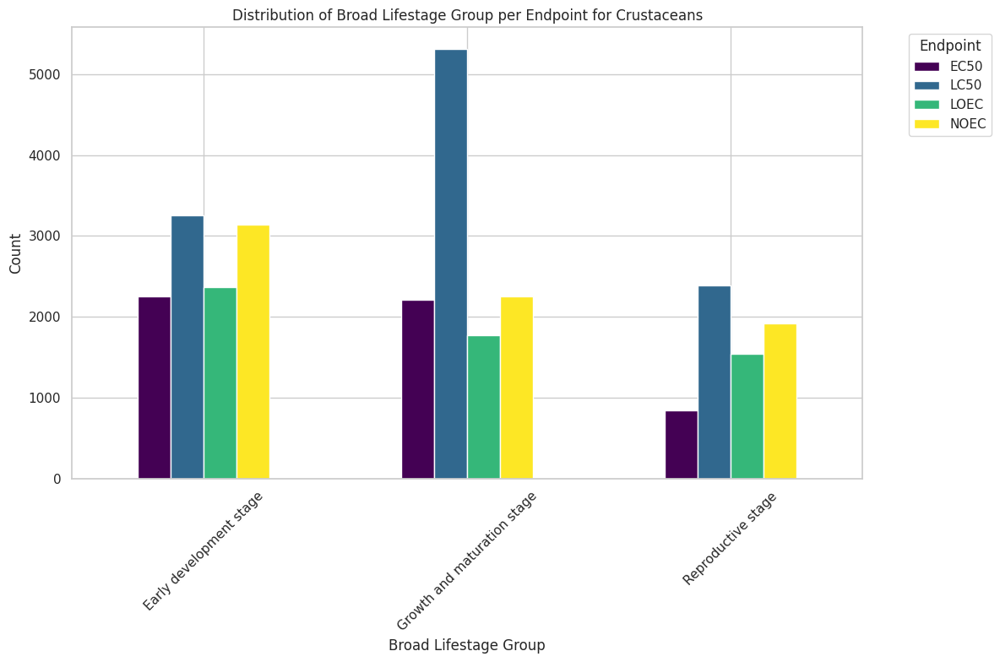

Data Distribution for Crustaceans:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage      2250  3250  2370  3136
Growth and maturation stage  2209  5313  1771  2251
Reproductive stage            841  2389  1539  1915 



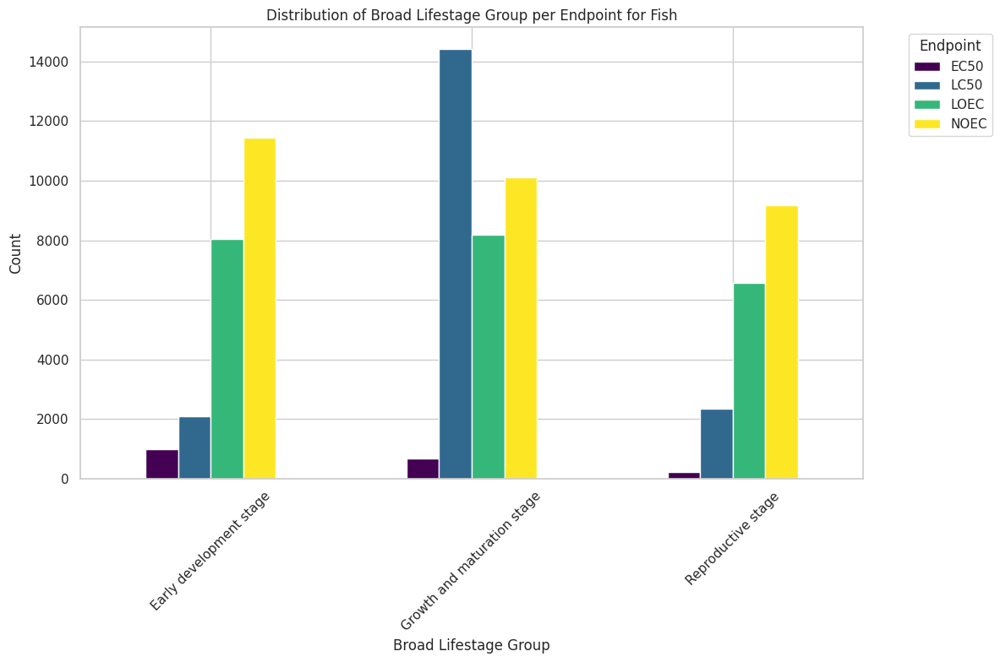

Data Distribution for Fish:
Endpoint                     EC50   LC50  LOEC   NOEC
Broad Lifestage Group                                
Early development stage       989   2079  8038  11442
Growth and maturation stage   667  14430  8197  10108
Reproductive stage            216   2343  6571   9175 



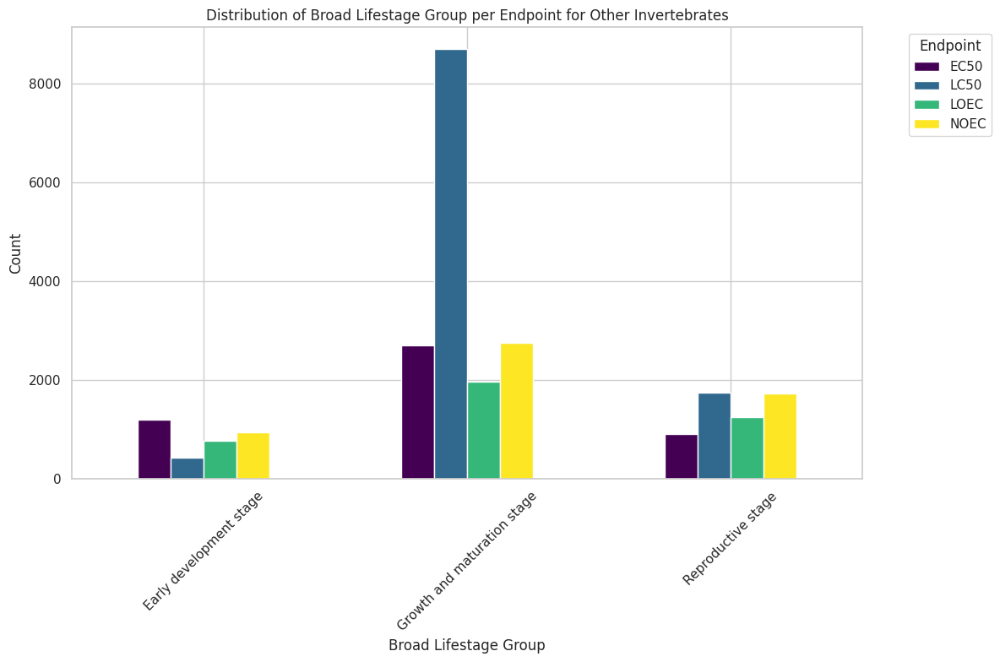

Data Distribution for Other Invertebrates:
Endpoint                     EC50  LC50  LOEC  NOEC
Broad Lifestage Group                              
Early development stage      1196   419   771   942
Growth and maturation stage  2699  8712  1961  2745
Reproductive stage            908  1735  1245  1721 



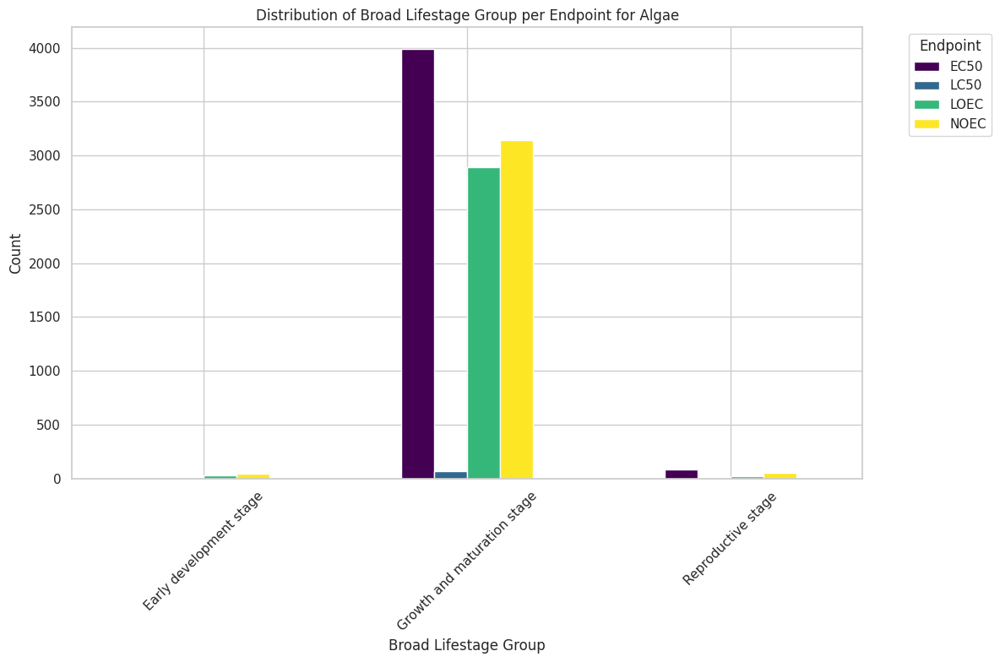

Data Distribution for Algae:
Endpoint                       EC50  LC50    LOEC    NOEC
Broad Lifestage Group                                    
Early development stage         6.0   0.0    29.0    48.0
Growth and maturation stage  3992.0  70.0  2893.0  3143.0
Reproductive stage             86.0   5.0    23.0    50.0 



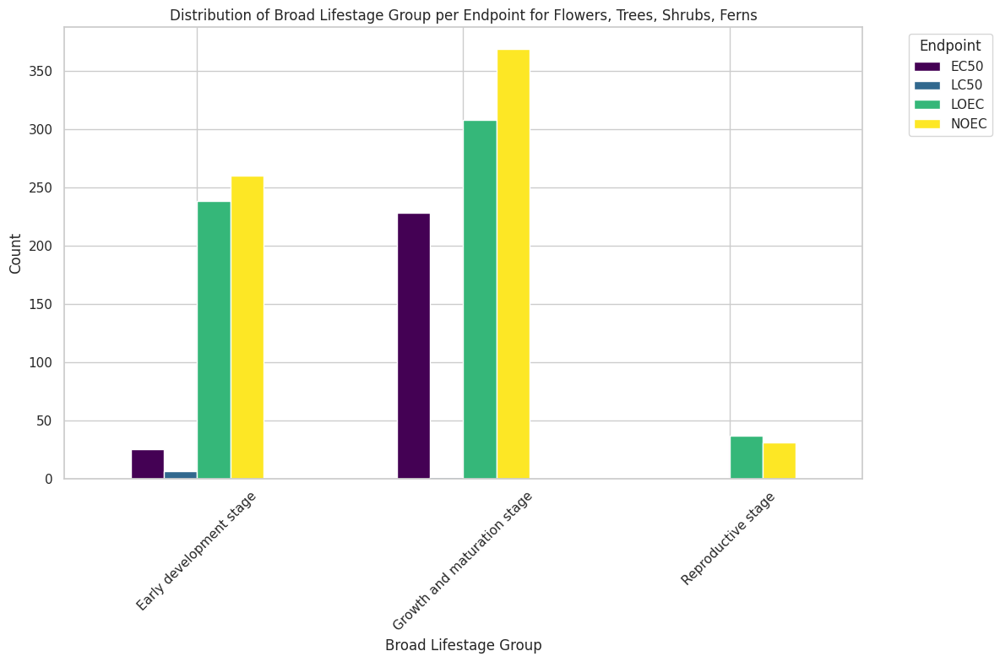

Data Distribution for Flowers, Trees, Shrubs, Ferns:
Endpoint                      EC50  LC50   LOEC   NOEC
Broad Lifestage Group                                 
Early development stage       25.0   6.0  238.0  260.0
Growth and maturation stage  228.0   1.0  308.0  369.0
Reproductive stage             0.0   0.0   37.0   31.0 



In [ ]:
# Get unique species from the 'Species Group' column
species_groups = filtered_df['Species Group'].unique()

# Create an empty dictionary to store DataFrame for each species
species_pivot_tables = {}

for species in species_groups:
    # Filter DataFrame for the current species
    df_species = filtered_df[filtered_df['Species Group'] == species]

    # Group by 'Endpoint' and 'Broad Lifestage Group' and count the occurrences
    endpoint_lifestage_counts = df_species.groupby(['Endpoint', 'Broad Lifestage Group']).size()

    # Reset the index to turn the results into a DataFrame
    endpoint_lifestage_counts_df = endpoint_lifestage_counts.reset_index(name='Count')

    # Pivot the DataFrame to get 'Broad Lifestage Group' as rows, 'Endpoint' as columns, and 'Count' as cell values
    pivoted_df = endpoint_lifestage_counts_df.pivot(index='Broad Lifestage Group', columns='Endpoint', values='Count').fillna(0)

    if len(pivoted_df) > 0:
        # Store the pivoted DataFrame in the dictionary using the species name as the key
        species_pivot_tables[species] = pivoted_df

        # Plotting the data for the current species
        pivoted_df.plot(kind='bar', stacked=False, figsize=(12, 8), colormap='viridis')

        # Customizing the plot
        plt.title(f'Distribution of Broad Lifestage Group per Endpoint for {species}')
        plt.xlabel('Broad Lifestage Group')
        plt.ylabel('Count')
        plt.xticks(rotation=45)  # Rotate labels to improve readability
        plt.legend(title='Endpoint', bbox_to_anchor=(1.05, 1), loc='upper left')

        # Show and save the plot
        plt.tight_layout()
        plt.savefig(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Figures/LifeStageData_distribution_{species}.png', dpi=300, bbox_inches='tight')
        plt.show()

        # Optionally print the pivoted DataFrame
        print(f"Data Distribution for {species}:")
        print(pivoted_df, "\n")
        pivoted_df.to_csv(f'Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/Stats/LifeStageData_distribution_{species}.csv')

In [ ]:
filtered_df['Species Group'].value_counts()

Species Group
Fish                             74255
Crustaceans                      29234
Other Invertebrates              25054
Amphibians                       10593
Algae                            10345
Flowers, Trees, Shrubs, Ferns     1503
Name: count, dtype: int64

In [ ]:
filtered_df = filtered_df[filtered_df['Species Group'].isin(['Fish', 'Crustaceans', 'Other Invertebrates', 'Amphibians'])]

In [ ]:
filtered_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 139136 entries, 0 to 163347
Data columns (total 15 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   CAS Number                     139136 non-null  int64  
 1   Chemical Name                  139136 non-null  object 
 2   Species Scientific Name        139136 non-null  object 
 3   Species Common Name            139136 non-null  object 
 4   Species Group                  139136 non-null  object 
 5   Organism Lifestage             139136 non-null  object 
 6   Observed Duration Mean (Days)  139136 non-null  float64
 7   Exposure Type                  139136 non-null  object 
 8   Media Type                     139136 non-null  object 
 9   Conc 1 Mean (Standardized)     139136 non-null  float64
 10  Conc 1 Units (Standardized)    139136 non-null  object 
 11  Effect                         139136 non-null  object 
 12  Effect Measurement             1391

In [ ]:
filtered_df.to_csv('Analysis&Modeling/Integrated Analysis/1.Life_Stage_Analysis/DataSet/3.LifeStageData-InvertebratesMerged&SpeciesFiltered.csv', index=False)

In [ ]:
filtered_df.dtypes

CAS Number                         int64
Chemical Name                     object
Species Scientific Name           object
Species Common Name               object
Species Group                     object
Organism Lifestage                object
Observed Duration Mean (Days)    float64
Exposure Type                     object
Media Type                        object
Conc 1 Mean (Standardized)       float64
Conc 1 Units (Standardized)       object
Effect                            object
Effect Measurement                object
Endpoint                          object
Broad Lifestage Group             object
SMILES                            object
CID                               object
dtype: object